# Hao_PBMC Level 2 ACT annotation result
Your JodID: 202411072322008JSYZM4EZ7NV6S
http://xteam.xbio.top/ACT/ResultAction.action?jobID=202411072322008JSYZM4EZ7NV6S

In [1]:
from pathlib import Path

# Get the current working directory as a Path object
current_path = Path.cwd()
home_folder = 'evan_home'

# Traverse up the directory tree until you find the target folder
for parent in [current_path] + list(current_path.parents):
    if parent.name == home_folder:
        home_path = parent
        break
else:
    raise ValueError(f"Folder '{home_folder}' not found in the current working directory.")

print("Home Path:", home_path)
source_code_dir = home_path / 'Source_code'
dataset_dir = home_path / 'Dataset'


Home Path: c:\Users\evanlee\Documents\Bmi_NAS_evan\evan_home


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
import os

In [2]:
!ls

ACT_Annotation_L2_opt_lmbd.txt        ACT_query_L2_opt_lmbd.ipynb
ACT_annotation_L2_UMAP_opt_lmbd.ipynb


In [4]:
annot = pd.read_csv('a2_ACT_Annotation_L2_opt_lmbd.txt', index_col=0, sep='\t')

In [4]:
annot = annot.rename(columns={'whg.overlap': 'canonical.marker.overlap', 'gsea.overlap': 'gsea.DEG.overlap'})
annot.head(12)

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap
Order,,,,,,,,,
1,Clus_ASDC,Plasmacytoid dendritic cell,5.449832e-25,3.065006e-25,0.000233,9/93,15/295,"PLAC8,SOX4,TCF4,CST3,IRF8,LILRA4,CCDC50,PLD4,H...","PLAC8,SOX4,TCF4,APP,C12orf75,IRF8,LILRA4,DAB2,..."
2,Clus_ASDC,"Plasmacytoid dendritic cell, human",2.571687e-12,3.325457e-14,NaN,3/5,0/1,"LILRA4,CCDC50,PLD4",NaN
3,Clus_ASDC,Monocyte,1.969440e-09,1.044723e-11,0.114226,9/218,12/365,"CST3,ANXA2,TXN,ALOX5AP,HLA-DPA1,MALAT1,S100A9,...","S100A10,PLAC8,CST3,SAMHD1,ANXA2,CTSH,FCGRT,ALO..."
4,Clus_ASDC,Suppressor macrophage,3.299929e-07,7.111916e-09,NaN,2/16,0/1,"CST3,S100A9",NaN
5,Clus_ASDC,CD1c-positive myeloid dendritic cell,1.426883e-04,3.690215e-06,NaN,2/15,3/35,"CST3,S100A9","CST3,HLA-DPA1,S100A9"
6,Clus_ASDC,Myeloid dendritic cell,1.792991e-04,6.182728e-06,NaN,4/63,0/1,"CST3,PLD4,HLA-DPA1,S100A9",NaN
7,Clus_ASDC,Macrophage,2.004072e-04,4.080375e-06,0.122877,6/281,18/653,"CST3,ALOX5AP,HLA-DPA1,S100A9,CD52,FTL","S100A10,PLAC8,CST3,SAMHD1,ANXA2,AXL,CTSH,FCGRT..."
8,Clus_ASDC,Classical monocyte,6.027525e-04,2.957547e-05,NaN,3/122,2/66,"PLAC8,CST3,S100A9","CST3,S100A9"
9,Clus_ASDC,Granulocyte,1.474487e-03,8.262210e-05,NaN,3/69,3/40,"TCF4,HLA-DPA1,S100A9","CST3,S100A9,FTL"


In [5]:
annot['canonical.marker.overlap'] = annot['canonical.marker.overlap'].str.split(',').fillna('')
annot['gsea.DEG.overlap'] = annot['gsea.DEG.overlap'].str.split(',').fillna('')

In [6]:
annot['union'] = annot.apply(lambda row: list(set(row['canonical.marker.overlap']) | set(row['gsea.DEG.overlap'])), axis=1)
annot.head(12)

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_ASDC,Plasmacytoid dendritic cell,5.449832e-25,3.065006e-25,0.000233,9/93,15/295,"[PLAC8, SOX4, TCF4, CST3, IRF8, LILRA4, CCDC50...","[PLAC8, SOX4, TCF4, APP, C12orf75, IRF8, LILRA...","[HLA-DPA1, IRF8, RAB11FIP1, TXN, LILRA4, ALOX5..."
2,Clus_ASDC,"Plasmacytoid dendritic cell, human",2.571687e-12,3.325457e-14,NaN,3/5,0/1,"[LILRA4, CCDC50, PLD4]",,"[LILRA4, PLD4, CCDC50]"
3,Clus_ASDC,Monocyte,1.969440e-09,1.044723e-11,0.114226,9/218,12/365,"[CST3, ANXA2, TXN, ALOX5AP, HLA-DPA1, MALAT1, ...","[S100A10, PLAC8, CST3, SAMHD1, ANXA2, CTSH, FC...","[HLA-DPA1, CD52, ANXA2, S100A10, MALAT1, TXN, ..."
4,Clus_ASDC,Suppressor macrophage,3.299929e-07,7.111916e-09,NaN,2/16,0/1,"[CST3, S100A9]",,"[S100A9, CST3]"
5,Clus_ASDC,CD1c-positive myeloid dendritic cell,1.426883e-04,3.690215e-06,NaN,2/15,3/35,"[CST3, S100A9]","[CST3, HLA-DPA1, S100A9]","[HLA-DPA1, CST3, S100A9]"
6,Clus_ASDC,Myeloid dendritic cell,1.792991e-04,6.182728e-06,NaN,4/63,0/1,"[CST3, PLD4, HLA-DPA1, S100A9]",,"[HLA-DPA1, PLD4, S100A9, CST3]"
7,Clus_ASDC,Macrophage,2.004072e-04,4.080375e-06,0.122877,6/281,18/653,"[CST3, ALOX5AP, HLA-DPA1, S100A9, CD52, FTL]","[S100A10, PLAC8, CST3, SAMHD1, ANXA2, AXL, CTS...","[HLA-DPA1, CD52, IRF8, TMSB4X, ANXA2, S100A10,..."
8,Clus_ASDC,Classical monocyte,6.027525e-04,2.957547e-05,NaN,3/122,2/66,"[PLAC8, CST3, S100A9]","[CST3, S100A9]","[PLAC8, CST3, S100A9]"
9,Clus_ASDC,Granulocyte,1.474487e-03,8.262210e-05,NaN,3/69,3/40,"[TCF4, HLA-DPA1, S100A9]","[CST3, S100A9, FTL]","[HLA-DPA1, TCF4, FTL, CST3, S100A9]"


## Plot UMAP for marker genes (intersection with PreLect)

In [5]:
# adata = sc.read_h5ad('/Users/evanli/Documents/Research_datasets/PBMC_Hao/GSE164378_Hao/Harmony_noZ/Hao_Harmony_test_no_scale.h5ad')
adata = sc.read_h5ad(dataset_dir / 'PBMC_Hao/GSE164378_Hao/Harmony_noZ/Hao_Harmony_test_no_scale.h5ad')
adata.obs['celltype.l2'] = adata.obs['celltype.l2'].str.replace(' ', '_')
labels = adata.obs['celltype.l2']
types = np.unique(labels).tolist()
types

['ASDC',
 'B_intermediate',
 'B_memory',
 'B_naive',
 'CD14_Mono',
 'CD16_Mono',
 'CD4_CTL',
 'CD4_Naive',
 'CD4_Proliferating',
 'CD4_TCM',
 'CD4_TEM',
 'CD8_Naive',
 'CD8_Proliferating',
 'CD8_TCM',
 'CD8_TEM',
 'Doublet',
 'Eryth',
 'HSPC',
 'ILC',
 'MAIT',
 'NK',
 'NK_CD56bright',
 'NK_Proliferating',
 'Plasmablast',
 'Platelet',
 'Treg',
 'cDC1',
 'cDC2',
 'dnT',
 'gdT',
 'pDC']

c:\Users\evanlee\AppData\Local\Programs\Python\Python39\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
c:\Users\evanlee\AppData\Local\Programs\Python\Python39\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
c:\Users\evanlee\AppData\Local\Programs\Python\Python39\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_

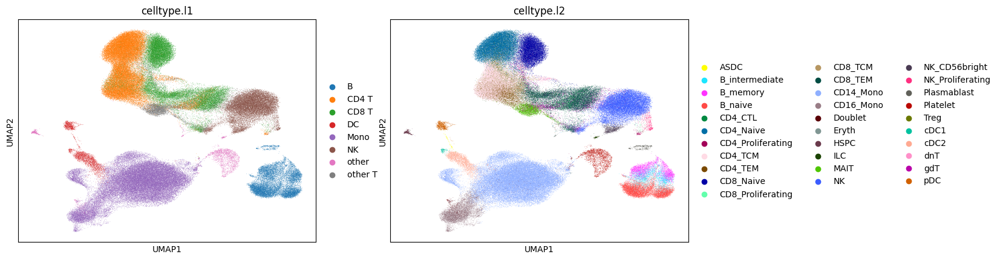

In [6]:
# UMAP embedding in adata
sc.pl.umap(adata, color=['celltype.l1', 'celltype.l2'], legend_loc="right margin")

## Plot UMAP of L2 overlapped marker genes (if celltype matched)

### B_memory 

In [9]:
annot[annot['Cluster']=='Clus_B_memory']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_B_memory,Memory B cell,1.207457e-21,5.329211e-23,0.003369,8/39,6/44,"[AIM2, HLA-DRA, BLK, BANK1, CD74, MS4A1, S100A...","[HLA-DRA, BANK1, CD74, TXNIP, MS4A1, HLA-DPB1]","[AIM2, CD74, BANK1, S100A10, HLA-DPB1, MS4A1, ..."
2,Clus_B_memory,Granulocyte,2.932694e-16,3.792277e-18,NaN,8/69,1/40,"[HLA-DRA, BANK1, TNFRSF13C, CD74, IGHA1, MS4A1...",[HLA-DRA],"[CD74, TNFRSF13C, BANK1, HLA-DPB1, JCHAIN, IGH..."
3,Clus_B_memory,Plasma cell,7.941446e-14,1.711518e-15,NaN,4/64,4/333,"[IGHA1, MS4A1, JCHAIN, IGHG1]","[CD74, IGHA1, JCHAIN, IGHG1]","[CD74, JCHAIN, MS4A1, IGHA1, IGHG1]"
4,Clus_B_memory,Dendritic cell,1.306673e-13,6.335694e-15,0.014052,5/143,6/307,"[LTB, HLA-DRA, CD74, JCHAIN, HLA-DPB1]","[HLA-DRA, CD74, MARCKS, S100A10, RPS20, HLA-DPB1]","[LTB, RPS20, CD74, HLA-DPB1, S100A10, MARCKS, ..."
5,Clus_B_memory,Natural T-regulatory cell,6.940697e-09,1.364330e-08,0.000578,3/13,10/133,"[CD74, ITGB1, HLA-DPB1]","[HLA-DRA, CD74, ITGB1, TXNIP, ARID5B, ATP2B1, ...","[EZR, CD74, HLA-DPB1, S100A10, TXNIP, ITGB1, H..."
6,Clus_B_memory,"Central memory CD4-positive, alpha-beta T cell",1.386221e-06,5.377582e-08,NaN,3/28,0/1,"[LTB, CD74, ITGB1]",,"[LTB, ITGB1, CD74]"
7,Clus_B_memory,"Activated CD4-positive, alpha-beta T cell",2.901437e-06,1.375681e-07,NaN,3/32,3/430,"[LTB, HLA-DRA, ITGB1]","[LTB, ITGB1, S100A10]","[LTB, ITGB1, HLA-DRA, S100A10]"
8,Clus_B_memory,Macrophage,2.901437e-06,3.552005e-07,0.019203,3/281,8/653,"[HLA-DRA, CD74, HLA-DPB1]","[HLA-DRA, CD74, MARCKS, TXNIP, ATP2B1, S100A10...","[CD74, HLA-DPB1, S100A10, MARCKS, HLA-DRA, TXN..."
9,Clus_B_memory,Conventional dendritic cell,5.256508e-06,2.718884e-07,NaN,3/22,4/99,"[HLA-DRA, CD74, HLA-DPB1]","[HLA-DRA, CD74, TXNIP, HLA-DPB1]","[HLA-DRA, CD74, TXNIP, HLA-DPB1]"


['AIM2', 'HLA-DRA', 'BLK', 'BANK1', 'CD74', 'MS4A1', 'S100A10', 'IGHG1']


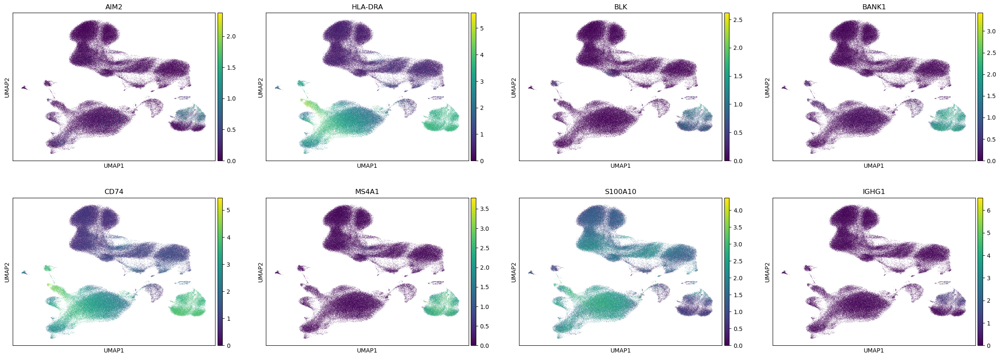

In [10]:
Bm_canon = annot[(annot['Cluster']=='Clus_B_memory') & (annot['Cell.Type']=='Memory B cell')]['canonical.marker.overlap'].tolist()[0]
print(Bm_canon)
sc.pl.umap(adata, color=Bm_canon)

### B_naive

In [11]:
annot[annot['Cluster']=='Clus_B_naive']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_B_naive,Naive B cell,1.246332e-39,2.289915e-42,0.023311,4/22,5/66,"[IGHM, TCL1A, IGHD, MS4A1]","[IGHM, TCL1A, IGHD, MS4A1, HLA-DRA]","[IGHD, TCL1A, MS4A1, IGHM, HLA-DRA]"
2,Clus_B_naive,B cell,1.334710e-19,6.539387e-21,0.003308,7/169,8/264,"[IGHM, TCL1A, IGHD, CXCR4, MS4A1, HLA-DRA, VIM]","[IGHM, TCL1A, IGHD, CXCR4, MS4A1, HLA-DRA, B2M...","[IGHD, CXCR4, VIM, B2M, TCL1A, MALAT1, MS4A1, ..."
3,Clus_B_naive,Memory B cell,2.540905e-17,1.568995e-19,0.059250,5/39,5/44,"[IGHM, TCL1A, IGHD, MS4A1, HLA-DRA]","[IGHM, TCL1A, IGHD, MS4A1, HLA-DRA]","[IGHD, TCL1A, MS4A1, IGHM, HLA-DRA]"
4,Clus_B_naive,Granulocyte,2.105218e-09,4.537107e-11,NaN,4/69,1/40,"[IGHM, IGHD, MS4A1, HLA-DRA]",[HLA-DRA],"[IGHM, IGHD, HLA-DRA, MS4A1]"
5,Clus_B_naive,Pro-B cell,3.464695e-09,3.458175e-12,0.944000,4/17,5/73,"[IGHM, TCL1A, MS4A1, HLA-DRA]","[IGHM, TCL1A, IGHD, CXCR4, HLA-DRA]","[IGHD, CXCR4, TCL1A, MS4A1, IGHM, HLA-DRA]"
6,Clus_B_naive,Plasmacytoid dendritic cell,2.433679e-06,7.342998e-08,NaN,4/93,4/295,"[TCL1A, IGHD, MS4A1, HLA-DRA]","[IGHM, TCL1A, CXCR4, HLA-DRA]","[IGHD, CXCR4, TCL1A, MS4A1, IGHM, HLA-DRA]"
7,Clus_B_naive,"Effector memory CD8-positive, alpha-beta T cell",9.826171e-06,3.811877e-07,NaN,2/47,2/78,"[CXCR4, HLA-DRA]","[IGHM, B2M]","[IGHM, HLA-DRA, B2M, CXCR4]"
8,Clus_B_naive,Endothelial cell,3.207540e-05,1.382560e-06,NaN,5/466,4/268,"[CXCR4, HLA-DRA, B2M, MALAT1, VIM]","[HLA-DRA, B2M, MALAT1, VIM]","[CXCR4, VIM, B2M, MALAT1, HLA-DRA]"
9,Clus_B_naive,Plasma cell,4.465010e-05,2.117031e-06,NaN,3/64,2/333,"[IGHM, MS4A1, VIM]","[IGHM, B2M]","[IGHM, VIM, B2M, MS4A1]"


['IGHM', 'TCL1A', 'IGHD', 'MS4A1']


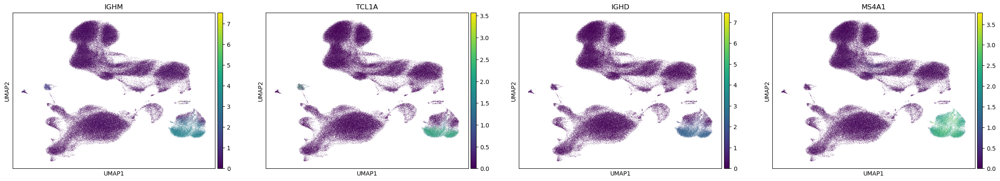

In [12]:
B_naive_canon = annot[(annot['Cluster']=='Clus_B_naive') & (annot['Cell.Type']=='Naive B cell')]['canonical.marker.overlap'].tolist()[0]
print(B_naive_canon)
sc.pl.umap(adata, color=B_naive_canon)

### CD14_mono 

In [13]:
annot[annot['Cluster']=='Clus_CD14_Mono']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_CD14_Mono,CD14-positive monocyte,7.801943e-64,5.601448e-64,0.000077,6/25,16/155,"[CD14, LYZ, S100A8, FCN1, VCAN, S100A9]","[CD14, LYZ, NEAT1, S100A8, FCN1, VCAN, S100A9,...","[S100A8, FCN1, CYBB, CD14, CCL3, MS4A6A, MT-CO..."
2,Clus_CD14_Mono,Classical monocyte,7.972783e-52,1.144826e-53,0.007043,9/122,11/66,"[CD14, LYZ, NEAT1, S100A8, FCN1, VCAN, S100A9,...","[CD14, LYZ, S100A8, FCN1, VCAN, S100A9, MS4A6A...","[S100A8, FCN1, CYBB, CD14, CCL3, MS4A6A, S100A..."
3,Clus_CD14_Mono,Macrophage,2.233248e-39,3.756776e-42,0.103896,17/281,20/653,"[CD14, LYZ, NEAT1, S100A8, FCN1, VCAN, S100A9,...","[CD14, LYZ, NEAT1, S100A8, FCN1, VCAN, S100A9,...","[S100A8, FCN1, CYBB, TMSB4X, IFITM2, CD14, CCL..."
4,Clus_CD14_Mono,Suppressor macrophage,2.090955e-29,4.506369e-31,NaN,4/16,0/1,"[CD14, LYZ, S100A8, S100A9]",,"[LYZ, S100A8, S100A9, CD14]"
5,Clus_CD14_Mono,Intermediate monocyte,8.781458e-27,2.782484e-29,0.118488,6/21,14/168,"[CD14, LYZ, S100A8, FCN1, S100A9, CEBPD]","[LYZ, NEAT1, S100A8, FCN1, VCAN, S100A9, MS4A6...","[S100A8, FCN1, CYBB, IFITM2, CD14, MS4A6A, S10..."
6,Clus_CD14_Mono,Neutrophil,1.836828e-22,2.713926e-24,0.034836,6/117,11/280,"[CD14, LYZ, S100A8, S100A9, CCL3, IFITM2]","[CD14, LYZ, S100A8, FCN1, S100A9, CYBB, CTSS, ...","[S100A8, FCN1, IFITM2, CD14, CCL3, S100A9, MYL..."
7,Clus_CD14_Mono,CD1c-positive myeloid dendritic cell,6.192253e-20,2.135260e-21,NaN,4/15,4/35,"[LYZ, S100A8, VCAN, S100A9]","[LYZ, S100A8, VCAN, S100A9]","[S100A8, LYZ, VCAN, S100A9]"
8,Clus_CD14_Mono,Myeloid suppressor cell,9.724185e-16,2.949190e-15,0.000335,5/41,16/446,"[CD14, S100A8, FCN1, VCAN, S100A9]","[CD14, LYZ, NEAT1, S100A8, FCN1, VCAN, S100A9,...","[S100A8, FCN1, TMSB4X, IFITM2, CD14, MS4A6A, S..."
9,Clus_CD14_Mono,"CD14-positive, CD16-positive monocyte",8.627874e-15,2.896901e-17,0.351936,4/9,6/188,"[CD14, LYZ, S100A8, S100A9]","[LYZ, FCN1, CYBB, CTSS, NAP1L1, IFITM2]","[S100A8, FCN1, NAP1L1, IFITM2, CD14, LYZ, CTSS..."


['CD14', 'LYZ', 'S100A8', 'FCN1', 'VCAN', 'S100A9']


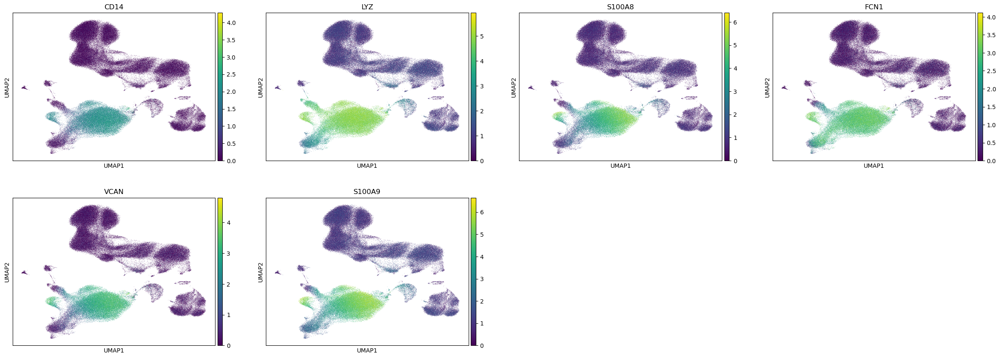

In [14]:
cd14_mono_canon = annot[(annot['Cluster']=='Clus_CD14_Mono') & (annot['Cell.Type']=='CD14-positive monocyte')]['canonical.marker.overlap'].tolist()[0]
print(cd14_mono_canon)
sc.pl.umap(adata, color=cd14_mono_canon)

### CD16_mono 

In [15]:
annot[annot['Cluster']=='Clus_CD16_Mono']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_CD16_Mono,Monocyte,7.672893e-41,9.245463e-42,0.000346,16/218,22/365,"[FCGR3A, LST1, AIF1, MS4A7, COTL1, CFD, PSAP, ...","[FCGR3A, LST1, AIF1, MS4A7, COTL1, TCF7L2, CFD...","[AIF1, MALAT1, HLA-A, PSAP, TCF7L2, NRGN, S100..."
2,Clus_CD16_Mono,Macrophage,3.304171e-29,4.052205e-32,0.092907,16/281,20/653,"[FCGR3A, LST1, AIF1, MS4A7, COTL1, PSAP, CEBPB...","[FCGR3A, LST1, AIF1, MS4A7, COTL1, CFD, PSAP, ...","[S100A8, HLA-DPA1, FCGR3A, TMSB4X, AIF1, MS4A7..."
3,Clus_CD16_Mono,Non-classical monocyte,3.658750e-28,1.692128e-28,0.000384,7/52,14/72,"[FCGR3A, LST1, AIF1, TCF7L2, CST3, FCER1G, CDK...","[FCGR3A, LST1, AIF1, MS4A7, COTL1, TCF7L2, CFD...","[HLA-DPA1, CDKN1C, FCGR3A, AIF1, MS4A7, FCER1G..."
4,Clus_CD16_Mono,"CD14-positive, CD16-positive monocyte",7.421765e-23,1.935483e-20,0.000001,3/9,15/188,"[FCGR3A, S100A9, S100A8]","[FCGR3A, LST1, AIF1, MS4A7, COTL1, TCF7L2, CFD...","[S100A8, HLA-DPA1, CDKN1C, FCGR3A, AIF1, MS4A7..."
5,Clus_CD16_Mono,Dendritic cell,4.501261e-18,8.085981e-19,0.002465,8/143,21/307,"[FCGR3A, LST1, AIF1, MS4A7, HLA-DPA1, SERPINA1...","[FCGR3A, LST1, AIF1, MS4A7, COTL1, TCF7L2, PSA...","[HLA-DPA1, FCGR3A, TMSB4X, PTMA, AIF1, RPLP1, ..."
6,Clus_CD16_Mono,"CD14-low, CD16-positive monocyte",5.404117e-18,1.225310e-18,0.002362,2/4,14/93,"[FCGR3A, MS4A7]","[FCGR3A, LST1, AIF1, COTL1, TCF7L2, CFD, PSAP,...","[HLA-DPA1, CDKN1C, FCGR3A, AIF1, MS4A7, FCER1G..."
7,Clus_CD16_Mono,Suppressor macrophage,3.204609e-16,9.669078e-18,NaN,4/16,0/1,"[FCGR3A, CST3, S100A9, S100A8]",,"[S100A8, S100A9, FCGR3A, CST3]"
8,Clus_CD16_Mono,Neutrophil,1.125673e-13,3.680131e-15,0.031480,4/117,8/280,"[FCGR3A, CST3, S100A9, S100A8]","[FCGR3A, LST1, AIF1, SERPINA1, FCER1G, S100A9,...","[S100A8, FCGR3A, AIF1, RPLP1, FCER1G, SERPINA1..."
9,Clus_CD16_Mono,Intermediate monocyte,2.633433e-13,4.577251e-16,0.675483,3/21,15/168,"[FCGR3A, S100A9, S100A8]","[FCGR3A, LST1, AIF1, MS4A7, COTL1, CFD, PSAP, ...","[S100A8, HLA-DPA1, FCGR3A, AIF1, MS4A7, SERPIN..."


['FCGR3A', 'S100A9', 'S100A8']


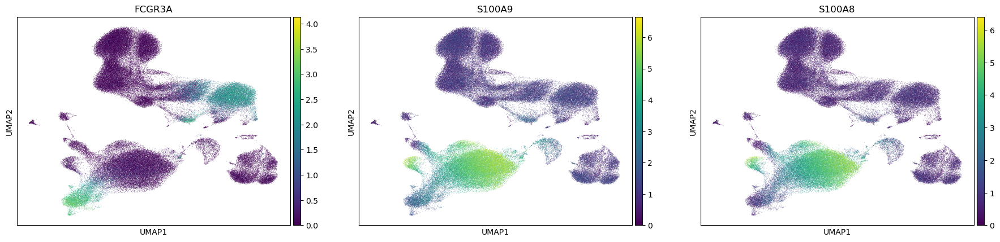

In [ ]:
cd16_mono_canon = annot[(annot['Cluster']=='Clus_CD16_Mono') & (annot['Cell.Type']=='CD14-positive, CD16-positive monocyte')]['canonical.marker.overlap'].tolist()[0]
print(cd16_mono_canon)
sc.pl.umap(adata, color=cd16_mono_canon)

### CD4_CTL

In [17]:
annot[annot['Cluster']=='Clus_CD4_CTL']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_CD4_CTL,"Effector memory CD4-positive, alpha-beta T cell",5.719580e-38,2.433864e-39,NaN,7/26,0/1,"[CD4, IL7R, ITGB1, GNLY, RORA, GZMA, CCL5]",,"[ITGB1, CCL5, GZMA, CD4, RORA, IL7R, GNLY]"
2,Clus_CD4_CTL,"CD4-positive, alpha-beta T cell",3.433343e-36,8.330690e-39,0.292585,10/93,21/281,"[CD4, NKG7, IL7R, TRBC1, HOPX, GNLY, CD2, ID2,...","[GZMH, CD4, NKG7, FGFBP2, IL7R, S100A4, TRBC1,...","[MAF, CD52, IL32, IL7R, NKG7, RPLP0, GZMH, TSC..."
3,Clus_CD4_CTL,Mature NK T cell,8.095925e-36,1.646837e-37,0.047141,9/39,17/141,"[NKG7, FGFBP2, IL7R, GNLY, CD52, IL32, CD2, GZ...","[GZMH, NKG7, FGFBP2, IL7R, TRBC1, HOPX, GNLY, ...","[CD52, IL32, IL7R, NKG7, GZMH, TSC22D3, TRBC1,..."
4,Clus_CD4_CTL,"Effector memory CD45RA-positive, alpha-beta T ...",3.539567e-35,5.560216e-33,0.000008,6/13,19/243,"[GZMH, CD4, NKG7, GNLY, GZMA, CCL5]","[GZMH, NKG7, FGFBP2, S100A4, HOPX, ITGB1, GNLY...","[CD52, IL32, NKG7, GZMH, HOPX, RORA, CD6, GNLY..."
5,Clus_CD4_CTL,"CD8-positive, alpha-beta cytotoxic T cell",1.418998e-30,8.820181e-30,0.000270,6/51,17/175,"[GZMH, NKG7, GNLY, CD2, GZMA, CCL5]","[GZMH, NKG7, FGFBP2, IL7R, TRBC1, HOPX, ITGB1,...","[CD52, IL32, IL7R, NKG7, GZMH, TSC22D3, TRBC1,..."
6,Clus_CD4_CTL,"Effector memory CD8-positive, alpha-beta T cell",9.847138e-27,1.134608e-27,0.019295,6/44,11/78,"[GZMH, NKG7, IL7R, GNLY, GZMA, CCL5]","[GZMH, NKG7, FGFBP2, IL7R, S100A4, ITGB1, GNLY...","[CD52, IL7R, NKG7, GZMH, GNLY, S100A4, CCL5, G..."
7,Clus_CD4_CTL,"CD8-positive, alpha-beta T cell",2.776069e-26,9.454615e-24,0.000008,11/96,20/293,"[GZMH, CD4, NKG7, FGFBP2, IL7R, TRBC1, ITGB1, ...","[GZMH, NKG7, FGFBP2, IL7R, S100A4, TRBC1, HOPX...","[CD52, IL32, IL7R, NKG7, GZMH, TSC22D3, TRBC1,..."
8,Clus_CD4_CTL,Effector T cell,8.666078e-26,2.652607e-27,0.096950,7/48,7/67,"[GZMH, NKG7, FGFBP2, GNLY, ID2, GZMA, CCL5]","[GZMH, NKG7, IL32, CD2, TSC22D3, GZMA, CCL5]","[CCL5, IL32, GZMA, ID2, NKG7, GZMH, TSC22D3, F..."
9,Clus_CD4_CTL,"CD4-positive, alpha-beta cytotoxic T cell",2.662497e-25,5.664886e-26,NaN,3/3,0/1,"[GZMH, NKG7, GNLY]",,"[NKG7, GZMH, GNLY]"


['GZMH', 'NKG7', 'GNLY']


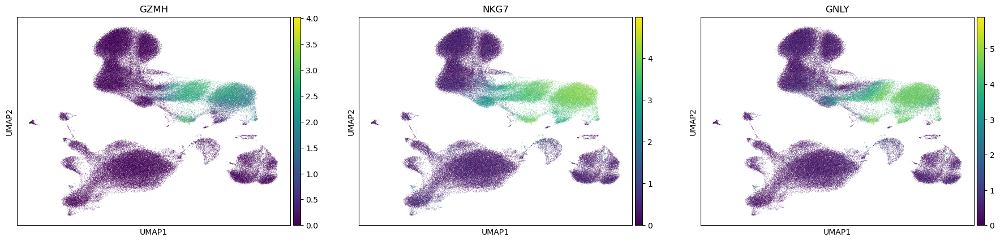

In [19]:
cd4_ctl_canon = annot[(annot['Cluster']=='Clus_CD4_CTL') & (annot['Cell.Type']=='CD4-positive, alpha-beta cytotoxic T cell')]['canonical.marker.overlap'].tolist()[0]
print(cd4_ctl_canon)
sc.pl.umap(adata, color=cd4_ctl_canon)

### CD4_Naive

In [22]:
annot[annot['Cluster']=='Clus_CD4_Naive']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_CD4_Naive,"Central memory CD4-positive, alpha-beta T cell",3.323323e-21,7.070900e-23,NaN,5/25,0/1,"[CD4, TMSB10, MAL, CCR7, LTB]",,"[LTB, TMSB10, MAL, CD4, CCR7]"
2,Clus_CD4_Naive,"CD4-positive, alpha-beta T cell",5.952726e-17,2.319573e-16,0.000264,5/93,17/281,"[CD4, CCR7, LTB, TCF7, CD40LG]","[TSHZ2, CD4, IL6ST, TRAT1, NOSIP, GIMAP7, RGS1...","[LTB, TSHZ2, NOSIP, RGS10, ITM2A, BCL11B, TRAT..."
3,Clus_CD4_Naive,T cell,5.952726e-17,3.742481e-19,0.226034,9/221,14/225,"[CD4, TRAT1, GIMAP7, CD7, CCR7, LTB, TCF7, CD4...","[CD4, TRAT1, NOSIP, GIMAP7, RGS10, MAL, ITM2A,...","[LTB, NOSIP, CD247, RGS10, ITM2A, BCL11B, TRAT..."
4,Clus_CD4_Naive,Regulatory T cell,6.131811e-14,5.218562e-15,NaN,4/68,4/98,"[CD4, CD7, CCR7, CD40LG]","[NOSIP, CD7, LTB, CD247]","[LTB, NOSIP, CD247, CD4, CD40LG, CD7, CCR7]"
5,Clus_CD4_Naive,"Naive thymus-derived CD4-positive, alpha-beta ...",5.385766e-13,1.066894e-13,0.015323,3/13,15/111,"[CD4, CCR7, TCF7]","[FHIT, TSHZ2, TRAT1, NOSIP, ADTRP, GIMAP7, TMS...","[LTB, TSHZ2, NOSIP, BCL11B, ADTRP, TMSB10, TRA..."
6,Clus_CD4_Naive,"CD4-positive, alpha-beta memory T cell",7.053541e-11,3.049170e-12,0.133333,2/10,6/44,"[CD4, CCR7]","[TRAT1, MAL, CCR7, LTB, BCL11B, TCF7]","[LTB, CD4, BCL11B, TRAT1, MAL, TCF7, CCR7]"
7,Clus_CD4_Naive,"CD4-positive, CD25-positive, alpha-beta regula...",7.053541e-11,1.113732e-11,NaN,2/24,3/230,"[CD4, LTB]","[ITM2A, CD7, LTB]","[LTB, ITM2A, CD4, CD7]"
8,Clus_CD4_Naive,Helper T cell,7.053541e-11,5.040652e-13,0.642710,3/57,10/159,"[CD4, CCR7, CD40LG]","[TSHZ2, CD4, TRAT1, GIMAP7, ITM2A, CD7, LTB, C...","[LTB, TSHZ2, CD247, RPS27, ITM2A, CD4, TRAT1, ..."
9,Clus_CD4_Naive,"Effector memory CD4-positive, alpha-beta T cell",9.595081e-11,1.837356e-11,NaN,3/26,0/1,"[CD4, MAL, CCR7]",,"[MAL, CD4, CCR7]"


['CD4', 'CCR7', 'TCF7']


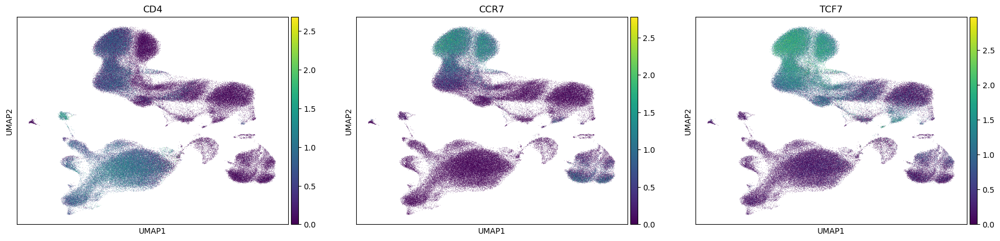

In [23]:
cd4_Naive_canon = annot[(annot['Cluster']=='Clus_CD4_Naive') & (annot['Cell.Type']=='Naive thymus-derived CD4-positive, alpha-beta T cell')]['canonical.marker.overlap'].tolist()[0]
print(cd4_Naive_canon)
sc.pl.umap(adata, color=cd4_Naive_canon)

### CD4_proliferating

In [24]:
annot[annot['Cluster']=='Clus_CD4_Proliferating']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_CD4_Proliferating,"Proliferating CD4-positive, alpha-beta T cell",7.109147e-22,3.025169e-23,NaN,3/3,0/1,"[STMN1, MKI67, TUBA1B]",,"[STMN1, TUBA1B, MKI67]"
2,Clus_CD4_Proliferating,"CD8-positive, alpha-beta T cell",2.128771e-11,3.402808e-11,0.001256,7/96,15/293,"[STMN1, TOP2A, TRAC, MKI67, TRBC2, TYMS, NUSAP1]","[STMN1, HMGB2, TOP2A, CD3D, TRAC, IL32, MKI67,...","[PCLAF, IL32, TYMS, CD3D, TUBB, STMN1, TUBA1B,..."
3,Clus_CD4_Proliferating,"CD4-positive, alpha-beta T cell",5.479663e-10,4.061032e-08,0.000041,5/93,5/281,"[STMN1, TOP2A, TRAC, MKI67, COTL1]","[CD3D, TRAC, IL32, TRBC2, SPOCK2]","[MKI67, COTL1, IL32, CD3D, TRAC, TOP2A, TRBC2,..."
4,Clus_CD4_Proliferating,"CD8-positive, alpha-beta cytotoxic T cell",5.980641e-06,9.162641e-07,0.038222,4/51,7/175,"[STMN1, HMGB2, TUBB, PCLAF]","[HMGB2, CD3D, TRAC, IL32, COTL1, TRBC2, SPOCK2]","[PCLAF, COTL1, IL32, SPOCK2, CD3D, TRAC, TUBB,..."
5,Clus_CD4_Proliferating,"Central memory CD4-positive, alpha-beta T cell",1.640064e-05,2.093699e-06,NaN,2/25,0/1,"[TRAC, IL32]",,"[TRAC, IL32]"
6,Clus_CD4_Proliferating,"Effector memory CD8-positive, alpha-beta T cell",2.642705e-05,3.935943e-06,NaN,3/44,0/78,"[TOP2A, TRAC, MKI67]",,"[TRAC, MKI67, TOP2A]"
7,Clus_CD4_Proliferating,Regulatory T cell,8.597896e-04,5.095469e-04,0.023270,3/68,6/98,"[TRAC, IL32, TRBC2]","[CD3D, TRAC, IL32, TRBC2, CORO1B, SPOCK2]","[IL32, CORO1B, CD3D, TRAC, TRBC2, SPOCK2]"
8,Clus_CD4_Proliferating,Gamma-delta T cell,6.959076e-03,1.042435e-03,0.141988,2/35,15/308,"[TOP2A, MKI67]","[STMN1, HMGB2, TOP2A, CD3D, TRAC, IL32, MKI67,...","[PCLAF, IL32, TYMS, CD3D, TUBB, STMN1, TUBA1B,..."
9,Clus_CD4_Proliferating,Helper T cell,7.984920e-03,3.391531e-03,0.057773,2/57,8/159,"[IL32, TRBC2]","[CD3D, LIMS1, TRAC, IL32, COTL1, ANP32E, TRBC2...","[COTL1, IL32, ANP32E, CORO1B, CD3D, TRAC, TRBC..."


['STMN1', 'MKI67', 'TUBA1B']


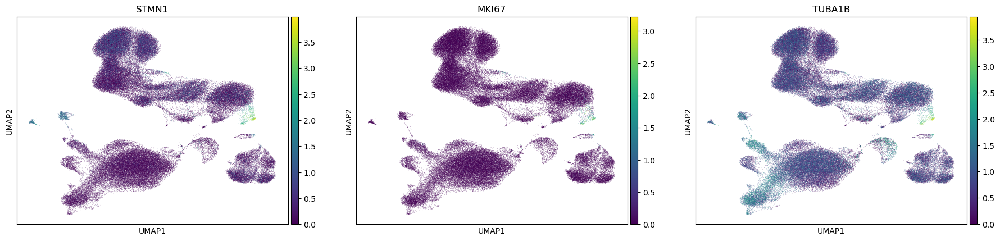

In [25]:
cd4_pro_canon = annot[(annot['Cluster']=='Clus_CD4_Proliferating') & (annot['Cell.Type']=='Proliferating CD4-positive, alpha-beta T cell')]['canonical.marker.overlap'].tolist()[0]
print(cd4_pro_canon)
sc.pl.umap(adata, color=cd4_pro_canon)

### CD4_TCM

In [26]:
annot[annot['Cluster']=='Clus_CD4_TCM']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_CD4_TCM,"Central memory CD4-positive, alpha-beta T cell",4.299578e-47,9.148038e-49,NaN,8/25,0/1,"[ITGB1, LTB, IL7R, AQP3, ANXA1, CD4, CD69, IL32]",,"[LTB, IL32, IL7R, CD4, ITGB1, AQP3, CD69, ANXA1]"
2,Clus_CD4_TCM,"Effector memory CD4-positive, alpha-beta T cell",1.997890e-42,8.501660e-44,NaN,6/26,0/1,"[ITGB1, IL7R, AQP3, ANXA1, CD4, RORA]",,"[ITGB1, AQP3, CD4, ANXA1, IL7R, RORA]"
3,Clus_CD4_TCM,"CD4-positive, alpha-beta T cell",3.192950e-29,3.011654e-29,0.000919,8/93,18/281,"[LTB, IL7R, GPR183, CD2, ANXA1, CD4, CD69, JUNB]","[ITGB1, LTB, IL7R, GPR183, MAF, CD2, CD52, ANX...","[LTB, MAF, FYB1, CD52, ITM2A, IL32, IL7R, GPR1..."
4,Clus_CD4_TCM,T cell,5.081876e-29,6.142715e-31,0.096579,8/221,17/225,"[LTB, IL7R, CD2, CD52, CD4, CD69, VIM, IL32]","[ITGB1, LTB, IL7R, GPR183, CD2, AQP3, CD52, AN...","[LTB, FYB1, CD52, IL32, ITM2A, IL7R, VIM, GPR1..."
5,Clus_CD4_TCM,Helper T cell,3.611989e-24,2.712044e-24,0.002310,6/57,14/159,"[IL7R, GPR183, CD52, CD4, CD69, IL32]","[LTB, LIMS1, IL7R, CD2, CD52, CD4, CORO1B, FYB...","[LTB, FYB1, CD52, IL32, ITM2A, IL7R, CORO1B, G..."
6,Clus_CD4_TCM,"Activated CD4-positive, alpha-beta T cell",5.483683e-23,1.997053e-23,0.006004,6/30,19/430,"[ITGB1, LTB, IL7R, ANXA1, CD4, CD69]","[ITGB1, LTB, IL7R, GPR183, CD2, AQP3, USP10, C...","[LTB, S100A11, FYB1, USP10, CD52, IL32, ITM2A,..."
7,Clus_CD4_TCM,Memory T cell,2.012202e-21,4.582311e-23,0.119874,5/16,10/214,"[LTB, IL7R, GPR183, CD69, S100A4]","[ITGB1, LTB, IL7R, GPR183, CD2, CD52, CD69, JU...","[LTB, CD52, IL32, IL7R, GPR183, CD69, ITGB1, I..."
8,Clus_CD4_TCM,Induced T-regulatory cell,6.237815e-15,1.061756e-15,NaN,2/4,0/1,"[IL7R, CD4]",,"[IL7R, CD4]"
9,Clus_CD4_TCM,T-helper 17 cell,6.342755e-15,1.214570e-15,NaN,3/31,0/1,"[IL7R, CD4, RORA]",,"[IL7R, RORA, CD4]"


['ITGB1', 'LTB', 'IL7R', 'AQP3', 'ANXA1', 'CD4', 'CD69', 'IL32']


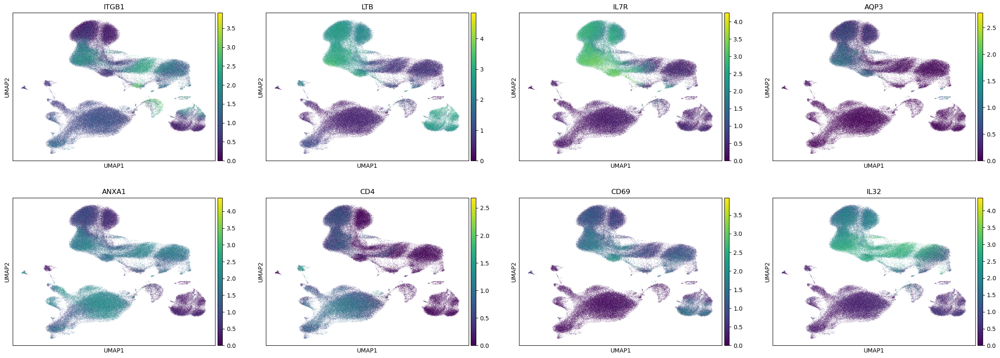

In [27]:
cd4_tcm_canon = annot[(annot['Cluster']=='Clus_CD4_TCM') & (annot['Cell.Type']=='Central memory CD4-positive, alpha-beta T cell')]['canonical.marker.overlap'].tolist()[0]
# Central memory CD4-positive, alpha-beta T cell
print(cd4_tcm_canon)
sc.pl.umap(adata, color=cd4_tcm_canon)

### CD4_TEM

In [28]:
annot[annot['Cluster']=='Clus_CD4_TEM']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_CD4_TEM,"Effector memory CD4-positive, alpha-beta T cell",1.571419e-62,6.686887e-64,NaN,8/26,0/1,"[GZMK, IL7R, CD4, KLRB1, CCL5, GZMA, ANXA1, CX...",,"[GZMK, CCL5, CXCR4, GZMA, IL7R, CD4, KLRB1, AN..."
2,Clus_CD4_TEM,T cell,1.571419e-62,3.235677e-62,0.000126,16/221,22/225,"[GZMK, IL7R, CD4, IL32, KLRB1, CD2, CCL5, GZMA...","[GZMK, IL7R, CD4, IL32, KLRB1, CD2, CCL5, GZMA...","[GZMK, KLF2, FYB1, IL32, IL7R, S100A10, CD69, ..."
3,Clus_CD4_TEM,"CD4-positive, alpha-beta T cell",2.887261e-47,2.528156e-48,0.006302,13/93,21/281,"[GZMK, IL7R, CD4, KLRB1, CD2, CCL5, GZMA, TNFA...","[GZMK, IL7R, CD4, IL32, KLRB1, SYNE2, CD2, CCL...","[GZMK, FYB1, IL32, IL7R, CD69, SYNE2, TNFAIP3,..."
4,Clus_CD4_TEM,"Central memory CD4-positive, alpha-beta T cell",2.700670e-46,2.298443e-47,NaN,9/25,0/1,"[IL7R, CD4, IL32, ANXA1, KLF2, ZFP36L2, LTB, T...",,"[KLF2, LTB, IL32, IL7R, CD4, ZFP36L2, TRAC, CD..."
5,Clus_CD4_TEM,"Effector memory CD8-positive, alpha-beta T cell",3.584080e-38,1.036909e-40,0.391160,8/44,6/78,"[GZMK, IL7R, KLRB1, CCL5, GZMA, TRAC, CD69, CX...","[GZMK, IL7R, CCL5, ANXA1, S100A4, AHNAK]","[GZMK, AHNAK, CCL5, CXCR4, GZMA, IL7R, TRAC, C..."
6,Clus_CD4_TEM,Helper T cell,1.978849e-32,7.354646e-33,0.004270,7/57,15/159,"[GZMK, IL7R, CD4, IL32, KLRB1, CD69, CXCR4]","[IL7R, CD4, IL32, KLRB1, SYNE2, CD2, LTB, ITM2...","[GZMK, LTB, AHNAK, FYB1, CXCR4, IL32, ITM2A, I..."
7,Clus_CD4_TEM,Memory T cell,7.701243e-28,6.707351e-28,0.002458,6/16,16/214,"[IL7R, KLRB1, KLF2, LTB, S100A4, CD69]","[GZMK, IL7R, IL32, SYNE2, CD2, CCL5, TNFAIP3, ...","[KLF2, LTB, GZMK, CXCR4, IL32, IL7R, CD69, TRB..."
8,Clus_CD4_TEM,"CD8-positive, alpha-beta T cell",1.605804e-27,4.488258e-27,0.000886,12/96,21/293,"[GZMK, IL7R, CD4, KLRB1, CD2, CCL5, GZMA, LTB,...","[GZMK, IL7R, IL32, KLRB1, SYNE2, CD2, CCL5, GZ...","[GZMK, IL32, IL7R, S100A10, CD69, TNFAIP3, ANX..."
9,Clus_CD4_TEM,"Effector CD4-positive, alpha-beta T cell",2.386788e-27,1.518807e-28,0.045643,4/7,11/89,"[GZMK, CD4, KLRB1, GZMA]","[GZMK, IL32, KLRB1, SYNE2, CCL5, GZMA, S100A4,...","[GZMK, S100A11, AHNAK, CCL5, IL32, GZMA, CD4, ..."


['GZMK', 'IL7R', 'CD4', 'KLRB1', 'CCL5', 'GZMA', 'ANXA1', 'CXCR4']


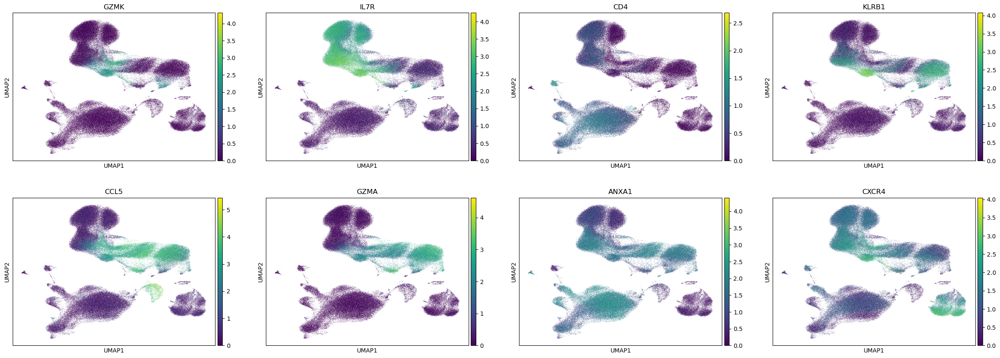

In [29]:
cd4_tem_canon = annot[(annot['Cluster']=='Clus_CD4_TEM') & (annot['Cell.Type']=='Effector memory CD4-positive, alpha-beta T cell')]['canonical.marker.overlap'].tolist()[0]
# Effector memory CD4-positive, alpha-beta T cell
print(cd4_tem_canon)
sc.pl.umap(adata, color=cd4_tem_canon)

### CD8_naive

In [30]:
annot[annot['Cluster']=='Clus_CD8_Naive']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_CD8_Naive,"Naive thymus-derived CD8-positive, alpha-beta ...",5.140341e-32,2.036377e-34,0.066066,5/13,19/179,"[CD8B, CD8A, NELL2, LEF1, NOSIP]","[CD8B, CD8A, LINC02446, NELL2, RGS10, PDE3B, P...","[NOSIP, RGS10, CD8A, AIF1, OXNAD1, RPS26, TMSB..."
2,Clus_CD8_Naive,"CD8-positive, alpha-beta T cell",2.711737e-26,5.267344e-28,0.032583,4/96,6/293,"[CD8B, CD8A, S100B, PASK]","[CD8B, CD8A, THEMIS, LEPROTL1, HCST, UQCRB]","[UQCRB, CD8A, HCST, THEMIS, LEPROTL1, CD8B, PA..."
3,Clus_CD8_Naive,"CD8-positive, alpha-beta cytotoxic T cell",1.961411e-17,1.384092e-19,0.263575,2/51,5/175,"[CD8B, CD8A]","[CD8B, CD8A, LEPROTL1, HCST, ATM]","[ATM, LEPROTL1, CD8A, HCST, CD8B]"
4,Clus_CD8_Naive,"Central memory CD8-positive, alpha-beta T cell",1.961411e-17,1.521033e-18,NaN,2/9,3/40,"[CD8B, CD8A]","[CD8B, CD8A, LINC02446]","[CD8A, LINC02446, CD8B]"
5,Clus_CD8_Naive,"Double-positive, alpha-beta thymocyte",4.615040e-17,4.909617e-18,NaN,2/5,0/1,"[CD8B, CD8A]",,"[CD8B, CD8A]"
6,Clus_CD8_Naive,"Effector memory CD8-positive, alpha-beta T cell",1.338648e-16,1.708913e-17,NaN,2/44,2/78,"[CD8B, CD8A]","[CD8B, CD8A]","[CD8B, CD8A]"
7,Clus_CD8_Naive,T cell,5.241962e-16,3.795593e-18,0.491820,5/221,12/225,"[CD8B, CD8A, LEF1, THEMIS, AIF1]","[CD8B, CD8A, RGS10, PASK, PRMT2, LEF1, RPS26, ...","[NOSIP, RGS10, CD8A, AIF1, RPS26, LEPROTL1, CD..."
8,Clus_CD8_Naive,Naive T cell,2.328117e-14,3.962753e-15,NaN,4/19,11/192,"[CD8B, CD8A, LEF1, LRRN3]","[RGS10, PDE3B, LEF1, RPS26, NUCB2, LEPROTL1, H...","[NOSIP, RGS10, CD8A, HCST, AIF1, ACTN1, RPS26,..."
9,Clus_CD8_Naive,Mature NK T cell,3.065309e-13,5.869741e-14,NaN,2/39,4/141,"[CD8B, CD8A]","[S100B, LEF1, HCST, AIF1]","[LEF1, CD8A, HCST, AIF1, CD8B, S100B]"


['CD8B', 'CD8A', 'NELL2', 'LEF1', 'NOSIP']


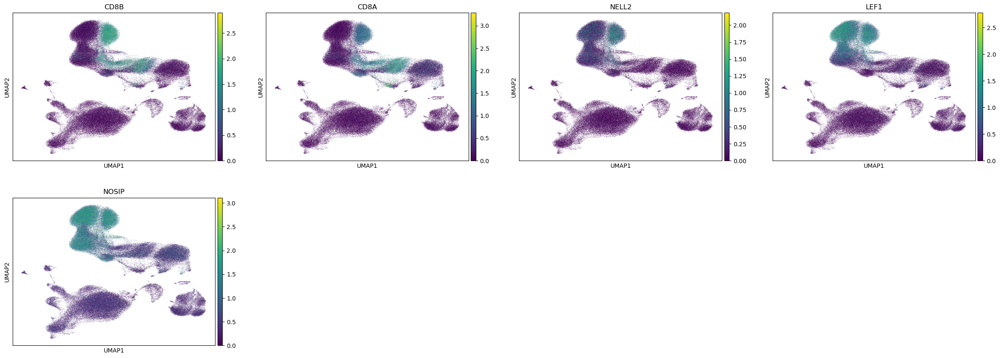

In [31]:
cd8_naive_canon = annot[(annot['Cluster']=='Clus_CD8_Naive') & (annot['Cell.Type']=='Naive thymus-derived CD8-positive, alpha-beta T cell')]['canonical.marker.overlap'].tolist()[0]  # Naive T cell
print(cd8_naive_canon)
sc.pl.umap(adata, color=cd8_naive_canon)

### CD8_TCM

In [46]:
annot[annot['Cluster']=='Clus_CD8_TCM']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_CD8_TCM,"CD8-positive, alpha-beta T cell",1.144368e-37,1.626092e-39,0.022200,8/96,13/293,"[CD8B, CCL5, CD8A, IL7R, LTB, ITGB1, S100A10, ...","[CD8B, CCL5, CD8A, IL7R, ANXA1, LTB, ZFP36L2, ...","[LTB, CD8A, IL32, IL7R, S100A10, GPR183, LEPRO..."
2,Clus_CD8_TCM,"Central memory CD4-positive, alpha-beta T cell",1.144368e-37,4.869651e-39,NaN,8/25,0/1,"[IL7R, ANXA1, LTB, ZFP36L2, ITGB1, LDHB, KLF2,...",,"[LTB, KLF2, IL32, IL7R, ZFP36L2, ITGB1, LDHB, ..."
3,Clus_CD8_TCM,T cell,1.851098e-37,1.856925e-38,0.006852,10/221,16/225,"[CD8B, CCL5, CD8A, IL7R, LTB, ZFP36L2, LDHB, K...","[CD8B, CCL5, CD8A, IL7R, ANXA1, LTB, ZFP36L2, ...","[LTB, KLF2, CD8A, IL32, IL7R, VIM, S100A10, GP..."
4,Clus_CD8_TCM,"Effector memory CD8-positive, alpha-beta T cell",1.237358e-36,5.104105e-38,0.022760,5/44,6/78,"[CD8B, CCL5, CD8A, IL7R, GPR183]","[CD8B, CCL5, CD8A, IL7R, ANXA1, ITGB1]","[CD8A, CCL5, IL7R, GPR183, ITGB1, ANXA1, CD8B]"
5,Clus_CD8_TCM,"Effector memory CD4-positive, alpha-beta T cell",7.746025e-33,8.240452e-34,NaN,4/26,0/1,"[CCL5, IL7R, ANXA1, ITGB1]",,"[ANXA1, IL7R, ITGB1, CCL5]"
6,Clus_CD8_TCM,"CD4-positive, alpha-beta T cell",3.809743e-30,2.206687e-28,0.000029,9/93,11/281,"[CD8B, CCL5, CD8A, IL7R, ANXA1, LTB, COTL1, LD...","[CCL5, IL7R, ANXA1, LTB, ZFP36L2, ITGB1, LDHB,...","[LTB, CD8A, IL32, IL7R, GPR183, LEPROTL1, LDHB..."
7,Clus_CD8_TCM,"CD8-positive, alpha-beta cytotoxic T cell",6.485711e-27,3.560178e-27,0.004025,5/51,11/175,"[CD8B, CCL5, CD8A, ANXA1, VIM]","[CD8B, CCL5, CD8A, IL7R, LTB, ZFP36L2, ITGB1, ...","[LTB, CD8A, IL32, IL7R, VIM, LEPROTL1, CD8B, C..."
8,Clus_CD8_TCM,Mature NK T cell,4.501771e-24,3.969913e-26,0.318335,5/39,5/141,"[CD8B, CCL5, CD8A, IL7R, IL32]","[CCL5, IL7R, YBX3, LTB, IL32]","[LTB, CD8A, CCL5, IL32, IL7R, CD8B, YBX3]"
9,Clus_CD8_TCM,"Naive thymus-derived CD8-positive, alpha-beta ...",3.057239e-23,1.757772e-25,0.568687,3/13,13/179,"[CD8B, CD8A, IL7R]","[CD8B, CCL5, CD8A, IL7R, LTB, ZFP36L2, LDHB, K...","[LTB, KLF2, CD8A, IL32, IL7R, GPR183, LEPROTL1..."


['CD8B', 'CD8A', 'IL7R', 'GPR183']


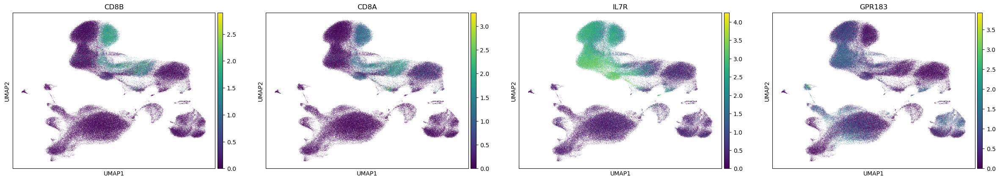

In [47]:
cd8_tcm_canon = annot[(annot['Cluster']=='Clus_CD8_TCM') & (annot['Cell.Type']=='Central memory CD8-positive, alpha-beta T cell')]['canonical.marker.overlap'].tolist()[0]
print(cd8_tcm_canon)
sc.pl.umap(adata, color=cd8_tcm_canon)

### CD8_TEM

In [32]:
annot[annot['Cluster']=='Clus_CD8_TEM']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_CD8_TEM,"Effector memory CD8-positive, alpha-beta T cell",1.419056e-70,2.820283e-72,6.267091e-03,10/44,10/78,"[CD8A, CD8B, TRAC, NKG7, CCL5, KLRD1, GZMK, TR...","[CD8A, CD8B, NKG7, CCL5, KLRD1, GZMK, GZMH, CS...","[GZMK, CD8A, NKG7, TRGC2, GZMH, CD8B, CTSW, CC..."
2,Clus_CD8_TEM,T cell,1.161219e-57,6.174567e-57,5.708185e-05,12/221,21/225,"[CD8A, CD8B, TRAC, NKG7, CCL5, KLRD1, GZMK, TR...","[CD8A, CD8B, TRAC, DUSP2, NKG7, CCL5, KLRD1, G...","[GZMK, KLF2, IL32, TRGC2, CTSW, PPP2R5C, KLRD1..."
3,Clus_CD8_TEM,"CD8-positive, alpha-beta cytotoxic T cell",3.884463e-53,9.933741e-50,1.930476e-07,8/51,25/175,"[CD8A, CD8B, NKG7, CCL5, GZMK, TRGC2, GZMH, CST7]","[CD8A, CD8B, TRAC, DUSP2, NKG7, CCL5, KLRD1, G...","[GZMK, IL32, PIK3R1, TRGC2, CTSW, PPP2R5C, KLR..."
4,Clus_CD8_TEM,"CD8-positive, alpha-beta T cell",1.594927e-50,3.162749e-48,3.491018e-06,11/96,25/293,"[CD8A, CD8B, TRAC, DUSP2, NKG7, CCL5, GZMK, TR...","[CD8A, CD8B, TRAC, DUSP2, NKG7, CCL5, KLRD1, G...","[GZMK, IL32, PIK3R1, TRGC2, CTSW, PPP2R5C, KLR..."
5,Clus_CD8_TEM,Mature NK T cell,1.718072e-41,1.018329e-42,1.764354e-02,7/39,17/141,"[CD8A, CD8B, NKG7, CCL5, KLRD1, TRGC2, IL32]","[TRAC, DUSP2, NKG7, CCL5, KLRD1, GZMK, CD3G, C...","[GZMK, DUSP2, CD8A, IL32, NKG7, CD3D, TRGC2, G..."
6,Clus_CD8_TEM,"Effector memory CD45RA-positive, alpha-beta T ...",2.509591e-27,1.002580e-26,4.662537e-04,5/13,18/243,"[NKG7, CCL5, GZMK, GZMH, CST7]","[DUSP2, NKG7, CCL5, GZMK, CD3G, TRGC2, CD3D, G...","[GZMK, DUSP2, IL32, NKG7, HLA-DPB1, CD3D, TRGC..."
7,Clus_CD8_TEM,"Naive thymus-derived CD8-positive, alpha-beta ...",4.473611e-27,4.909233e-29,2.002002e-01,4/13,22/179,"[CD8A, CD8B, GZMK, GZMH]","[CD8A, CD8B, DUSP2, NKG7, CCL5, KLRD1, GZMK, C...","[GZMK, KLF2, EZR, DUSP2, CD8A, IL32, NKG7, PIK..."
8,Clus_CD8_TEM,Effector T cell,1.572699e-20,6.351805e-22,9.081633e-02,7/48,15/67,"[NKG7, CCL5, KLRD1, GZMK, GZMH, JUNB, TXNIP]","[CD8A, CD8B, TRAC, DUSP2, NKG7, CCL5, GZMK, CD...","[GZMK, DUSP2, CD8A, IL32, NKG7, HLA-DPB1, CD3D..."
9,Clus_CD8_TEM,"Effector CD8-positive, alpha-beta T cell",8.414317e-19,1.790280e-19,NaN,3/8,0/1,"[CD8A, CD8B, NKG7]",,"[CD8B, NKG7, CD8A]"


['CD8A', 'CD8B', 'TRAC', 'NKG7', 'CCL5', 'KLRD1', 'GZMK', 'TRGC2', 'GZMH', 'CST7']


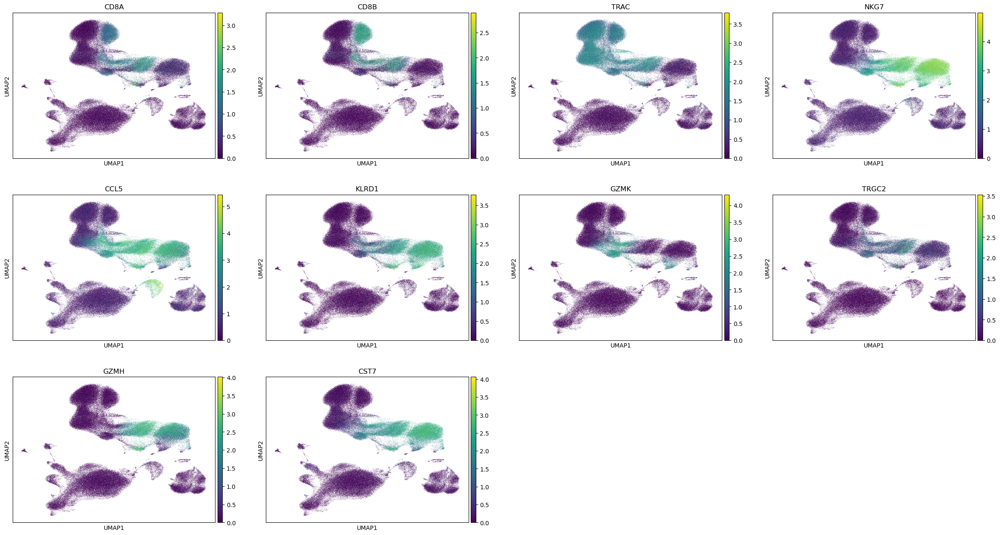

In [33]:
cd8_tem_canon = annot[(annot['Cluster']=='Clus_CD8_TEM') & (annot['Cell.Type']=='Effector memory CD8-positive, alpha-beta T cell')]['canonical.marker.overlap'].tolist()[0]
# Effector memory CD8-positive, alpha-beta T cell
print(cd8_tem_canon)
sc.pl.umap(adata, color=cd8_tem_canon)

### cDC1 and cDC2 (conventional DC)

In [34]:
annot[annot['Cluster']=='Clus_cDC1']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_cDC1,Type 1 conventional dendritic cell,2.401224e-23,3.699042e-23,0.000090,5/38,17/234,"[IRF8, CLEC9A, ID2, HLA-DPA1, BATF3]","[IRF8, CPVL, CLEC9A, CPNE3, C1orf54, CST3, WDF...","[HLA-DQB1, HLA-DPA1, IRF8, SNX3, HLA-DPB1, S10..."
2,Clus_cDC1,Monocyte,5.342291e-17,8.099076e-17,0.000183,11/218,16/365,"[CST3, HLA-DPB1, HLA-DPA1, HLA-DQB1, HLA-DRB1,...","[CPVL, CST3, S100A10, HLA-DPB1, HLA-DPA1, HLA-...","[HLA-DQB1, HLA-DPA1, OAZ1, CD52, HLA-DPB1, S10..."
3,Clus_cDC1,Macrophage,7.786475e-15,1.281641e-16,0.025383,13/281,22/653,"[CLEC9A, CST3, HLA-DPB1, HLA-DPA1, HLA-DQB1, H...","[IRF8, CPVL, C1orf54, CST3, ID2, BASP1, S100A1...","[OAZ1, CD52, IRF8, S100A10, TYROBP, ITM2B, S10..."
4,Clus_cDC1,Myeloid dendritic cell,1.483009e-12,3.196140e-14,NaN,7/63,0/1,"[CLEC9A, CST3, HLA-DPB1, HLA-DPA1, HLA-DQB1, H...",,"[HLA-DQB1, HLA-DPA1, S100A9, CST3, HLA-DPB1, C..."
5,Clus_cDC1,Conventional dendritic cell,2.001696e-12,5.646334e-15,0.260825,5/22,10/99,"[IRF8, CLEC9A, CST3, HLA-DPB1, HLA-DRB1]","[IRF8, CST3, HLA-DPB1, HLA-DPA1, HLA-DQB1, HLA...","[HLA-DQB1, HLA-DPA1, IRF8, CTSS, HLA-DPB1, CLE..."
6,Clus_cDC1,"CD141-positive, CLEC9A-positive dendritic cell",4.030760e-12,4.635109e-12,0.000766,2/5,10/99,"[CLEC9A, HLA-DPA1]","[CPVL, CLEC9A, CPNE3, WDFY4, SNX3, ID2, HLA-DP...","[HLA-DQB1, HLA-DPA1, WDFY4, SNX3, ID2, HLA-DPB..."
7,Clus_cDC1,Plasmacytoid dendritic cell,3.505156e-11,8.908230e-14,0.425275,4/93,6/295,"[IRF8, CST3, HLA-DPA1, HLA-DRB1]","[IRF8, WDFY4, HLA-DPB1, HLA-DPA1, HLA-DQB1, HL...","[HLA-DQB1, HLA-DPA1, WDFY4, IRF8, HLA-DPB1, CS..."
8,Clus_cDC1,B cell,5.191442e-08,4.521070e-07,0.000205,6/169,11/264,"[CST3, HLA-DPB1, HLA-DPA1, HLA-DQB1, HLA-DRB1,...","[IRF8, WDFY4, HLA-DPB1, HLA-DPA1, HLA-DQB1, HL...","[HLA-DQB1, HLA-DPA1, OAZ1, CD52, IRF8, HLA-DPB..."
9,Clus_cDC1,Suppressor macrophage,5.236295e-08,2.482726e-09,NaN,2/16,0/1,"[CST3, S100A9]",,"[S100A9, CST3]"


In [35]:
annot[annot['Cluster']=='Clus_cDC2']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_cDC2,CD1c-positive myeloid dendritic cell,2.696243e-34,1.177765e-37,0.225490,5/15,8/35,"[FCER1A, CLEC10A, CST3, LYZ, HLA-DRA]","[FCER1A, HLA-DQA1, CLEC10A, HLA-DPB1, CST3, LY...","[HLA-DPA1, LYZ, CLEC10A, HLA-DPB1, FCER1A, HLA..."
2,Clus_cDC2,"Dendritic cell, human",2.931741e-28,3.791045e-30,NaN,2/6,0/1,"[FCER1A, CLEC10A]",,"[CLEC10A, FCER1A]"
3,Clus_cDC2,Monocyte,1.749131e-24,7.403998e-26,0.006372,10/218,8/365,"[HLA-DQA1, CLEC10A, HLA-DPB1, CST3, LYZ, HLA-D...","[HLA-DQA1, HLA-DPB1, CST3, LYZ, HLA-DRA, HLA-D...","[HLA-DQB1, HLA-DPA1, FTL, LYZ, CLEC10A, HLA-DP..."
4,Clus_cDC2,Conventional dendritic cell,3.080868e-24,9.139393e-27,0.115100,6/22,8/99,"[FCER1A, CLEC10A, HLA-DPB1, CST3, LYZ, HLA-DRA]","[HLA-DQA1, CLEC10A, HLA-DPB1, CST3, LYZ, HLA-D...","[HLA-DQB1, HLA-DPA1, LYZ, CLEC10A, HLA-DPB1, F..."
5,Clus_cDC2,Type 2 conventional dendritic cell,5.845857e-23,5.203410e-25,0.048472,2/22,10/184,"[FCER1A, CLEC10A]","[FCER1A, HLA-DQA1, CLEC10A, HLA-DPB1, CST3, LY...","[HLA-DQB1, HLA-DPA1, FTL, LYZ, CLEC10A, HLA-DP..."
6,Clus_cDC2,Myeloid dendritic cell,2.390779e-22,7.213559e-24,NaN,9/63,0/1,"[FCER1A, HLA-DQA1, CLEC10A, HLA-DPB1, CST3, LY...",,"[HLA-DQB1, HLA-DPA1, LYZ, CLEC10A, HLA-DPB1, F..."
7,Clus_cDC2,Macrophage,1.345255e-17,2.445193e-18,0.004031,9/281,11/653,"[HLA-DQA1, HLA-DPB1, CST3, LYZ, HLA-DRA, HLA-D...","[FCER1A, HLA-DQA1, CLEC10A, HLA-DPB1, CST3, LY...","[HLA-DQB1, HLA-DPA1, CLEC10A, HLA-DPB1, HLA-DR..."
8,Clus_cDC2,B cell,5.636353e-11,4.210324e-10,0.000185,6/169,7/264,"[HLA-DQA1, HLA-DPB1, CST3, HLA-DRA, HLA-DQB1, ...","[HLA-DQA1, HLA-DPB1, HLA-DRA, HLA-DQB1, HLA-DP...","[HLA-DQB1, HLA-DPA1, HLA-DPB1, B2M, MALAT1, HL..."
9,Clus_cDC2,Suppressor macrophage,8.009952e-11,3.797822e-12,NaN,2/16,0/1,"[CST3, LYZ]",,"[LYZ, CST3]"


In [40]:
annot[
    (annot['Cluster'].isin(['Clus_cDC1', 'Clus_cDC2'])) & 
    (annot['Cell.Type'] == 'Conventional dendritic cell')
]['canonical.marker.overlap'].tolist()

[['IRF8', 'CLEC9A', 'CST3', 'HLA-DPB1', 'HLA-DRB1'],
 ['FCER1A', 'CLEC10A', 'HLA-DPB1', 'CST3', 'LYZ', 'HLA-DRA']]

In [42]:
cdc1_canon = annot[(annot['Cluster']=='Clus_cDC1') & (annot['Cell.Type']=='Type 1 conventional dendritic cell')]['canonical.marker.overlap'].tolist()[0]
cdc2_canon = annot[(annot['Cluster']=='Clus_cDC2') & (annot['Cell.Type']=='Type 2 conventional dendritic cell')]['canonical.marker.overlap'].tolist()[0]
cdc1_cdc2 = annot[
    (annot['Cluster'].isin(['Clus_cDC1', 'Clus_cDC2'])) & 
    (annot['Cell.Type'] == 'Conventional dendritic cell')
]['canonical.marker.overlap'].tolist()
cdc_canon = cdc1_cdc2[0] + cdc1_cdc2[1]

print('cDC1:', cdc1_canon)
print('cDC2:', cdc2_canon)
print('cDC:', cdc_canon)

cDC1: ['IRF8', 'CLEC9A', 'ID2', 'HLA-DPA1', 'BATF3']
cDC2: ['FCER1A', 'CLEC10A']
cDC: ['IRF8', 'CLEC9A', 'CST3', 'HLA-DPB1', 'HLA-DRB1', 'FCER1A', 'CLEC10A', 'HLA-DPB1', 'CST3', 'LYZ', 'HLA-DRA']


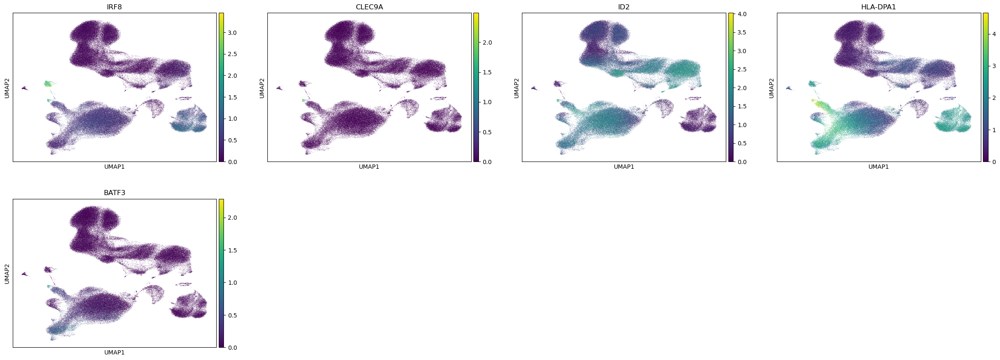

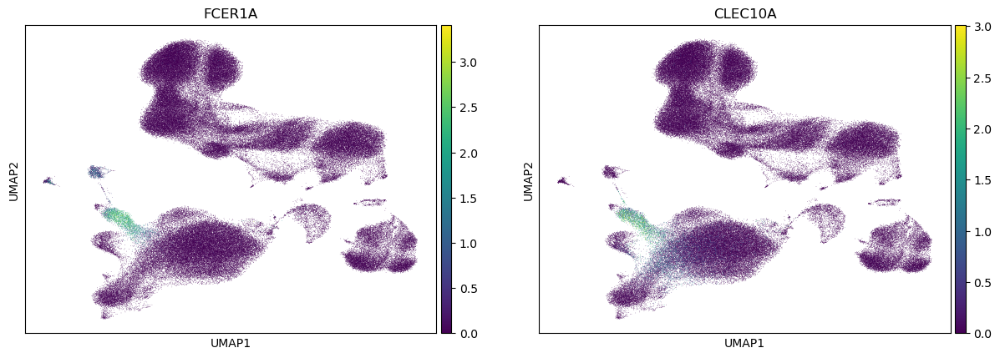

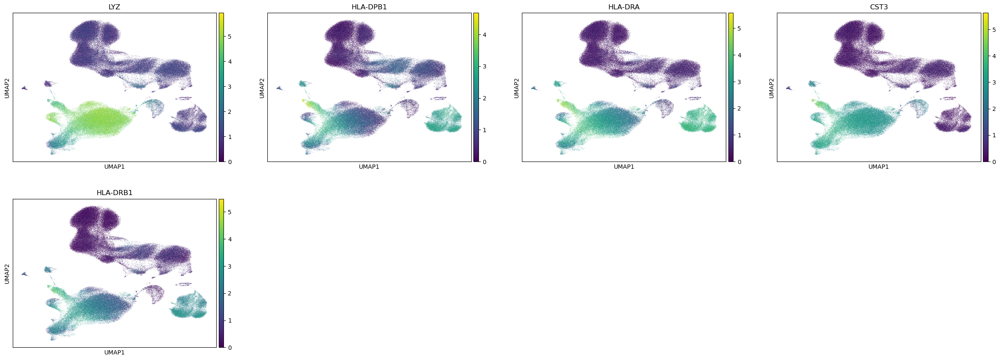

In [ ]:
sc.pl.umap(adata, color=cdc1_canon)
sc.pl.umap(adata, color=cdc2_canon)
sc.pl.umap(adata, color=list(set(cdc_canon) - set(cdc2_canon) - set(cdc1_canon)))  # not much use

### gdT

In [44]:
annot[annot['Cluster']=='Clus_gdT']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_gdT,Gamma-delta T cell,2.091964e-24,8.146445e-25,0.000860,4/35,15/308,"[TRDC, TRGC1, TRGC2, CCL5]","[TRDC, TRGC1, CD3D, CD3G, TRGC2, DUSP2, CCL5, ...","[DUSP2, IFITM2, IL32, RPLP1, MALAT1, CD3D, MT-..."
2,Clus_gdT,Mature NK T cell,2.146476e-14,9.537584e-16,0.024368,6/39,10/141,"[TRDC, TRGC1, TRGC2, CCL5, IL32, GNLY]","[TRDC, CD3D, CD3G, DUSP2, CCL5, IL32, CD3E, MA...","[DUSP2, IL32, MALAT1, CD3D, TRGC1, TRGC2, CD3E..."
3,Clus_gdT,"CD8-positive, alpha-beta cytotoxic T cell",2.472852e-13,1.096033e-13,0.005322,5/51,13/175,"[TRDC, TRGC1, TRGC2, CCL5, GNLY]","[TRDC, TRGC1, CD3D, CD3G, TRGC2, DUSP2, CCL5, ...","[DUSP2, IL32, MALAT1, CD3D, TRGC1, TRGC2, CD3E..."
4,Clus_gdT,"Effector memory CD8-positive, alpha-beta T cell",2.472852e-13,1.912701e-14,NaN,4/44,3/78,"[TRGC2, CCL5, TMSB4X, GNLY]","[CCL5, B2M, GNLY]","[TRGC2, CCL5, TMSB4X, B2M, GNLY]"
5,Clus_gdT,T cell,1.630122e-11,1.626144e-11,0.003382,7/221,14/225,"[TRDC, TRGC1, CCL5, IL32, MALAT1, ACTB, GNLY]","[TRDC, CD3D, CD3G, TRGC2, DUSP2, CCL5, IL32, C...","[DUSP2, TMSB4X, IFITM2, IL32, MALAT1, CD3D, RP..."
6,Clus_gdT,"Effector memory CD4-positive, alpha-beta T cell",2.128228e-08,2.716887e-09,NaN,2/26,0/1,"[CCL5, GNLY]",,"[CCL5, GNLY]"
7,Clus_gdT,"Effector memory CD45RA-positive, alpha-beta T ...",9.201176e-07,9.888468e-08,0.080612,2/13,13/243,"[CCL5, GNLY]","[CD3D, CD3G, TRGC2, DUSP2, CCL5, IL32, B2M, MA...","[DUSP2, CCL5, IFITM2, IL32, B2M, MALAT1, CD3D,..."
8,Clus_gdT,"Effector memory CD8-positive, alpha-beta T cel...",1.011180e-05,1.161039e-06,0.109808,2/14,8/167,"[CCL5, GNLY]","[DUSP2, CCL5, PPP2R5C, B2M, TMSB4X, RPLP1, ACT...","[PPP2R5C, DUSP2, CCL5, TMSB4X, RPLP1, B2M, ACT..."
9,Clus_gdT,"CD8-positive, alpha-beta T cell",1.128635e-05,2.799189e-05,0.005665,3/96,16/293,"[DUSP2, CCL5, GNLY]","[TRDC, TRGC1, CD3D, CD3G, TRGC2, DUSP2, CCL5, ...","[DUSP2, TMSB4X, IFITM2, IL32, MALAT1, CD3D, TR..."


['TRDC', 'TRGC1', 'TRGC2', 'CCL5']


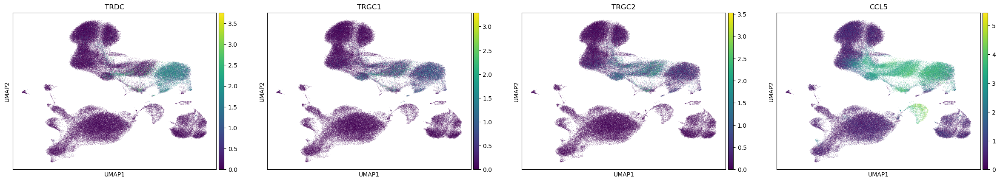

In [45]:
gdt_canon = annot[(annot['Cluster']=='Clus_gdT') & (annot['Cell.Type']=='Gamma-delta T cell')]['canonical.marker.overlap'].tolist()[0]
print(gdt_canon)
sc.pl.umap(adata, color=gdt_canon)

### HSPC

In [48]:
annot[annot['Cluster']=='Clus_HSPC']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_HSPC,Progenitor cell,6.117703e-10,1.293777e-12,0.065539,4/178,10/479,"[CDK6, SOX4, SPINK2, STMN1]","[SOX4, SPINK2, ZFAS1, SERPINB1, STMN1, NPM1, P...","[SERPINB1, PRSS57, HLA-B, NPM1, CDK6, S100A6, ..."
2,Clus_HSPC,Macrophage,5.663460e-05,1.059725e-07,0.249744,6/281,10/653,"[STMN1, ANKRD28, AIF1, BTG1, B2M, S100A6]","[SERPINB1, STMN1, AIF1, TMSB4X, HLA-B, BTG1, B...","[SERPINB1, TMSB4X, AIF1, HLA-B, S100A6, TMSB10..."
3,Clus_HSPC,Hematopoietic stem cell,1.593983e-04,2.748247e-06,NaN,2/88,3/125,"[SOX4, SPINK2]","[SPINK2, SERPINB1, ANKRD28]","[SERPINB1, SPINK2, ANKRD28, SOX4]"
4,Clus_HSPC,Endothelial cell,4.895342e-04,1.055031e-05,NaN,6/466,6/268,"[HLA-B, B2M, S100A6, TMSB10, HLA-C, MALAT1]","[TMSB4X, HLA-B, B2M, TMSB10, HLA-C, MALAT1]","[HLA-C, TMSB4X, HLA-B, B2M, MALAT1, S100A6, TM..."
5,Clus_HSPC,Neuron,7.864118e-04,2.408242e-04,0.005834,2/174,7/288,"[SOX4, B2M]","[SOX4, ZFAS1, STMN1, NPM1, TMSB4X, S100A6, TMS...","[TMSB4X, B2M, NPM1, S100A6, ZFAS1, TMSB10, STM..."
6,Clus_HSPC,Megakaryocyte-erythroid progenitor cell,8.369989e-04,2.537567e-05,NaN,2/19,1/67,"[CDK6, SOX4]",[SERPINB1],"[CDK6, SERPINB1, SOX4]"
7,Clus_HSPC,Monocyte,7.088916e-03,9.666628e-05,0.334511,4/218,5/365,"[STMN1, AIF1, S100A6, MALAT1]","[SERPINB1, AIF1, S100A6, TMSB10, HLA-C]","[SERPINB1, HLA-C, AIF1, MALAT1, S100A6, TMSB10..."
8,Clus_HSPC,Fibroblast,1.892918e-02,1.149209e-04,0.985507,4/309,8/687,"[SOX4, STMN1, S100A6, HLA-C]","[SOX4, STMN1, NPM1, TMSB4X, B2M, S100A6, TMSB1...","[HLA-C, TMSB4X, B2M, NPM1, MALAT1, S100A6, TMS..."


['SOX4', 'SPINK2']


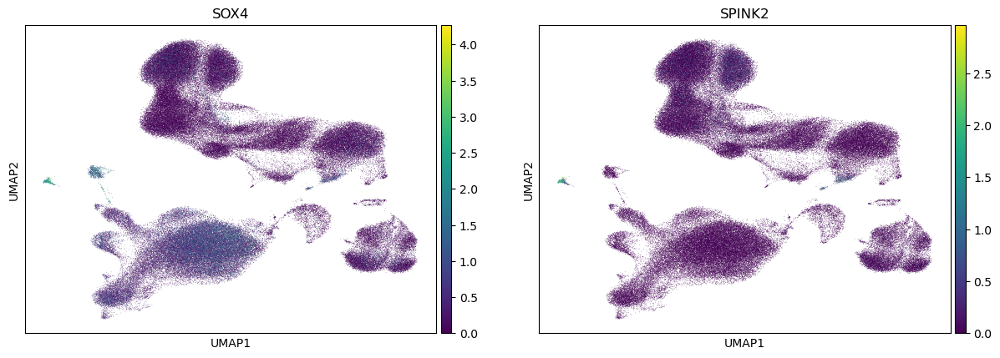

In [49]:
hspc_canon = annot[(annot['Cluster']=='Clus_HSPC') & (annot['Cell.Type']=='Hematopoietic stem cell')]['canonical.marker.overlap'].tolist()[0]
print(hspc_canon)
sc.pl.umap(adata, color=hspc_canon)

### MAIT

In [50]:
annot[annot['Cluster']=='Clus_MAIT']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_MAIT,"Effector memory CD8-positive, alpha-beta T cell",2.741794e-50,1.206594e-52,0.078556,9/44,8/78,"[KLRB1, IL7R, GZMK, CD8A, NKG7, CXCR4, GZMA, C...","[IL7R, GZMK, CD8A, S100A6, NKG7, S100A4, CTSW,...","[GZMK, CTSW, CD8A, CXCR4, CCL5, GZMA, IL7R, NK..."
2,Clus_MAIT,"Effector memory CD4-positive, alpha-beta T cell",1.134997e-44,7.244659e-46,NaN,8/26,0/1,"[KLRB1, IL7R, GZMK, CXCR4, AQP3, RORA, GZMA, C...",,"[GZMK, CXCR4, CCL5, GZMA, IL7R, AQP3, KLRB1, R..."
3,Clus_MAIT,Mucosal invariant T cell,1.917052e-39,1.847229e-40,0.009088,7/17,21/81,"[KLRB1, NCR3, IL7R, SLC4A10, CD8A, CXCR4, RORA]","[KLRB1, NCR3, IL7R, GZMK, SLC4A10, CD8A, DUSP2...","[GZMK, LTB, DUSP2, CD8A, CXCR4, IL7R, SLC4A10,..."
4,Clus_MAIT,"CD8-positive, alpha-beta T cell",5.515564e-37,2.729250e-36,0.000236,12/96,19/293,"[KLRB1, IL7R, GZMK, CD8A, DUSP2, NKG7, TRBC2, ...","[KLRB1, NCR3, IL7R, GZMK, CD8A, DUSP2, NKG7, T...","[GZMK, LTB, DUSP2, CD8A, CXCR4, IL7R, NKG7, KL..."
5,Clus_MAIT,Mature NK T cell,8.518133e-37,9.063272e-38,0.013240,7/39,19/141,"[KLRB1, NCR3, IL7R, CD8A, NKG7, GZMA, CCL5]","[KLRB1, NCR3, IL7R, GZMK, DUSP2, NKG7, TRBC2, ...","[GZMK, LTB, DUSP2, CD8A, CXCR4, IL7R, NKG7, KL..."
6,Clus_MAIT,"CD4-positive, alpha-beta T cell",1.264463e-29,2.684118e-31,0.095142,11/93,16/281,"[KLRB1, IL7R, GZMK, CD8A, NKG7, LTB, ID2, KLRG...","[KLRB1, IL7R, GZMK, DUSP2, NKG7, TRBC2, CXCR4,...","[GZMK, LTB, DUSP2, CD8A, CXCR4, IL7R, NKG7, KL..."
7,Clus_MAIT,"CD8-positive, alpha-beta cytotoxic T cell",4.580605e-27,1.120398e-27,0.010289,6/51,18/175,"[GZMK, CD8A, NKG7, GZMA, CCL5, CD69]","[KLRB1, IL7R, GZMK, CD8A, DUSP2, NKG7, TRBC2, ...","[GZMK, LTB, DUSP2, CD8A, CXCR4, IL7R, NKG7, CD..."
8,Clus_MAIT,Helper T cell,1.200581e-25,2.651939e-25,0.001350,8/57,9/159,"[KLRB1, IL7R, GZMK, SLC4A10, TRBC2, CXCR4, DUS...","[KLRB1, IL7R, TRBC2, CXCR4, S100A4, LTB, LINC0...","[GZMK, LTB, CXCR4, IL7R, SLC4A10, DUSP1, LINC0..."
9,Clus_MAIT,"Effector CD4-positive, alpha-beta T cell",1.662384e-24,2.922940e-24,0.002171,4/7,11/89,"[KLRB1, GZMK, NKG7, GZMA]","[KLRB1, NCR3, GZMK, CD8A, S100A6, NKG7, S100A4...","[GZMK, CTSW, CD8A, CCL5, GZMA, NKG7, KLRG1, S1..."


['KLRB1', 'NCR3', 'IL7R', 'SLC4A10', 'CD8A', 'CXCR4', 'RORA']


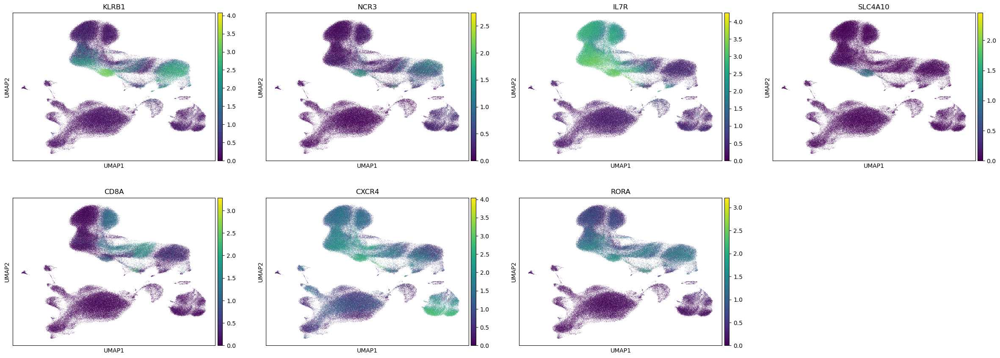

In [51]:
mait_canon = annot[(annot['Cluster']=='Clus_MAIT') & (annot['Cell.Type']=='Mucosal invariant T cell')]['canonical.marker.overlap'].tolist()[0]
print(mait_canon)
sc.pl.umap(adata, color=mait_canon)

### NK

In [52]:
annot[annot['Cluster']=='Clus_NK']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_NK,Natural killer cell,2.374589e-74,1.131744e-69,4.991827e-10,14/150,19/223,"[KLRF1, CD247, TYROBP, PRF1, NKG7, SPON2, GNLY...","[KLRF1, CD247, TYROBP, CLIC3, PRF1, NKG7, SPON...","[CD52, PTMA, TMSB4X, TYROBP, MALAT1, KLRD1, KL..."
2,Clus_NK,Mature NK T cell,1.881674e-66,1.542542e-68,6.484109e-03,12/42,14/141,"[KLRF1, TYROBP, PRF1, NKG7, GNLY, GZMB, CD7, K...","[CD247, CLIC3, PRF1, NKG7, GNLY, GZMB, CST7, C...","[KLRF1, CD247, FCGR3A, CD52, PRF1, NKG7, TYROB..."
3,Clus_NK,Circulating natural killer cell,2.564220e-41,1.857293e-42,1.725723e-03,6/12,13/87,"[TYROBP, NKG7, GNLY, GZMB, FCGR3A, KLRD1]","[KLRF1, TYROBP, CLIC3, PRF1, NKG7, SPON2, GNLY...","[KLRF1, FCGR3A, NKG7, PRF1, TYROBP, FCER1G, CL..."
4,Clus_NK,"CD8-positive, alpha-beta cytotoxic T cell",3.398622e-41,7.289049e-43,7.814253e-03,8/54,14/175,"[PRF1, NKG7, GNLY, GZMB, CST7, CD7, FCGR3A, VIM]","[KLRF1, CD247, PRF1, NKG7, GNLY, GZMB, CST7, C...","[KLRF1, CD247, FCGR3A, CD52, PRF1, NKG7, VIM, ..."
5,Clus_NK,"Effector memory CD8-positive, alpha-beta T cel...",4.304629e-27,1.057019e-29,1.257545e-01,5/14,17/167,"[PRF1, NKG7, GNLY, GZMB, KLRD1]","[KLRF1, TYROBP, PRF1, NKG7, GNLY, GZMB, CST7, ...","[KLRF1, FCGR3A, CD52, TMSB4X, RPLP1, PRF1, NKG..."
6,Clus_NK,CD16-positive natural killer cell,4.819385e-21,1.246393e-22,NaN,3/3,0/1,"[NKG7, GNLY, FCGR3A]",,"[NKG7, FCGR3A, GNLY]"
7,Clus_NK,"Effector memory CD8-positive, alpha-beta T cell",9.640681e-21,3.791800e-23,1.405295e-01,7/47,12/78,"[PRF1, NKG7, GNLY, CST7, KLRB1, KLRD1, TMSB4X]","[PRF1, NKG7, SPON2, GNLY, GZMB, CST7, FCGR3A, ...","[RPS2, TMSB4X, FCGR3A, CD52, PRF1, NKG7, GZMB,..."
8,Clus_NK,T cell,7.830802e-20,4.566784e-22,1.130172e-01,14/224,14/225,"[KLRF1, CD247, PRF1, NKG7, GNLY, GZMB, CD7, KL...","[CD247, PRF1, NKG7, GNLY, GZMB, CST7, CD7, KLR...","[KLRF1, CD247, FCGR3A, CD52, PTMA, TMSB4X, PRF..."
9,Clus_NK,"CD16-positive, CD56-dim natural killer cell, h...",7.707209e-19,2.989866e-20,NaN,3/4,0/1,"[NKG7, GNLY, FCGR3A]",,"[NKG7, FCGR3A, GNLY]"


['KLRF1', 'CD247', 'TYROBP', 'PRF1', 'NKG7', 'SPON2', 'GNLY', 'GZMB', 'CST7', 'CD7', 'KLRB1', 'FCGR3A', 'KLRD1', 'FCER1G']


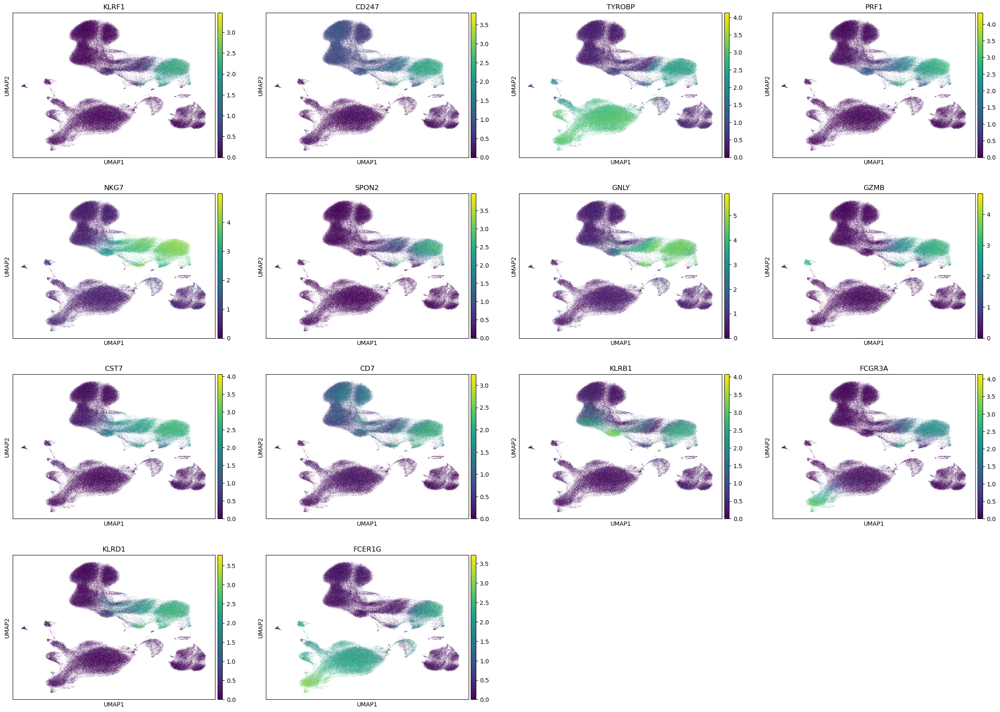

In [53]:
NK_canon = annot[(annot['Cluster']=='Clus_NK') & (annot['Cell.Type']=='Natural killer cell')]['canonical.marker.overlap'].tolist()[0]
print(NK_canon)
sc.pl.umap(adata, color=NK_canon)

### Plasmablast

In [55]:
annot[annot['Cluster']=='Clus_Plasmablast']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_Plasmablast,Plasma cell,1.243196e-49,3.178118e-48,0.000001,6/64,7/333,"[JCHAIN, MZB1, SEC11C, IGKC, IGHA1, IGLC2]","[JCHAIN, MZB1, SEC11C, IGKC, IGHA1, HSP90B1, I...","[IGLC2, MZB1, JCHAIN, IGHA1, HSP90B1, IGKC, SE..."
2,Clus_Plasmablast,Plasmablast,4.121670e-26,3.125426e-28,0.016613,3/16,7/40,"[JCHAIN, MZB1, IGHA1]","[JCHAIN, MZB1, SEC11C, IGKC, IGHA1, HSP90B1, I...","[IGLC2, MZB1, JCHAIN, IGHA1, HSP90B1, IGKC, SE..."
3,Clus_Plasmablast,Plasmacytoid dendritic cell,4.665246e-17,2.656643e-19,0.048523,5/93,8/295,"[JCHAIN, MZB1, IGKC, IGLC2, HLA-DRA]","[JCHAIN, MZB1, SEC11C, IGKC, HSP90B1, RPS27, R...","[IGLC2, RPS27, RPS12, MZB1, JCHAIN, HLA-DRA, H..."
4,Clus_Plasmablast,Granulocyte,1.646179e-10,2.838239e-12,NaN,5/69,2/40,"[JCHAIN, IGKC, IGHA1, IGLC2, HLA-DRA]","[FTH1, HLA-DRA]","[FTH1, HLA-DRA, IGLC2, IGKC, JCHAIN, IGHA1]"
5,Clus_Plasmablast,B cell,2.365750e-10,2.233400e-12,0.075053,6/169,8/264,"[JCHAIN, MZB1, IGKC, IGHA1, IGLC2, HLA-DRA]","[JCHAIN, MZB1, IGKC, IGHA1, IGLC2, MALAT1, RPS...","[IGLC2, RPS27, MZB1, JCHAIN, IGHA1, MALAT1, HL..."
6,Clus_Plasmablast,Dendritic cell,7.323833e-05,1.230687e-06,0.090476,4/143,5/307,"[JCHAIN, SEC11C, IGKC, HLA-DRA]","[TMSB4X, FTH1, HLA-DRA, RPL30, ACTB]","[TMSB4X, RPL30, ACTB, JCHAIN, FTH1, HLA-DRA, I..."
7,Clus_Plasmablast,Natural killer cell,1.395772e-02,4.211380e-04,NaN,3/150,4/223,"[MZB1, SEC11C, HLA-DRA]","[MALAT1, TMSB4X, RPS27, ACTB]","[ACTB, HLA-DRA, RPS27, TMSB4X, MZB1, SEC11C, M..."
8,Clus_Plasmablast,Memory B cell,1.845069e-02,6.778322e-04,NaN,2/39,2/44,"[SEC11C, HLA-DRA]","[IGKC, HLA-DRA]","[IGKC, HLA-DRA, SEC11C]"
9,Clus_Plasmablast,Monocyte,1.845069e-02,2.491750e-04,0.270907,3/218,5/365,"[MALAT1, FTH1, HLA-DRA]","[IGKC, IGLC2, FTH1, HLA-DRA, ACTB]","[IGLC2, MALAT1, FTH1, HLA-DRA, IGKC, ACTB]"


['JCHAIN', 'MZB1', 'IGHA1']


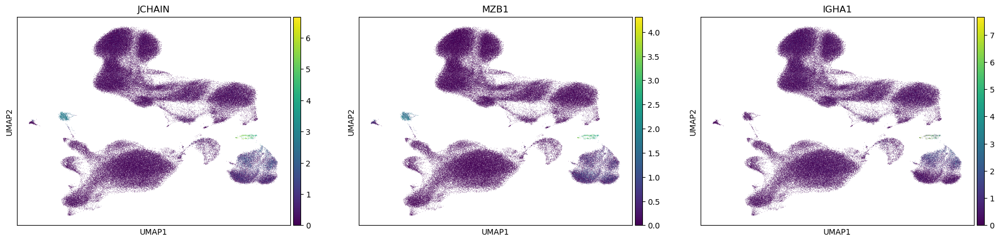

In [56]:
plasmablast_canon = annot[(annot['Cluster']=='Clus_Plasmablast') & (annot['Cell.Type']=='Plasmablast')]['canonical.marker.overlap'].tolist()[0]
print(plasmablast_canon)
sc.pl.umap(adata, color=plasmablast_canon)

### pDC

In [57]:
annot[annot['Cluster']=='Clus_pDC']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_pDC,Plasmacytoid dendritic cell,6.981446e-41,6.494890e-41,0.000045,6/93,8/295,"[TCF4, GZMB, CCDC50, IRF8, JCHAIN, IRF7]","[TCF4, GZMB, CCDC50, UGCG, IRF8, PPP1R14B, JCH...","[PPP1R14B, UGCG, IRF8, JCHAIN, IRF7, TCF4, GZM..."
2,Clus_pDC,Plasma cell,1.766091e-08,2.283739e-10,NaN,3/64,2/333,"[TCF4, GZMB, JCHAIN]","[JCHAIN, B2M]","[TCF4, GZMB, B2M, JCHAIN]"
3,Clus_pDC,Natural killer cell,2.957409e-06,6.373727e-08,NaN,2/150,4/223,"[GZMB, TXNIP]","[GZMB, TMSB4X, MALAT1, TXNIP]","[TMSB4X, GZMB, TXNIP, MALAT1]"
4,Clus_pDC,Dendritic cell,5.525205e-06,1.207091e-08,0.599565,5/143,7/307,"[TCF4, GZMB, IRF8, JCHAIN, IRF7]","[TCF4, UGCG, IRF8, PPP1R14B, IRF7, TMSB4X, B2M]","[PPP1R14B, UGCG, TMSB4X, IRF8, B2M, JCHAIN, IR..."
5,Clus_pDC,"Plasmacytoid dendritic cell, human",3.237698e-04,1.395559e-05,NaN,2/5,0/1,"[CCDC50, IRF7]",,"[IRF7, CCDC50]"
6,Clus_pDC,Granulocyte,2.851779e-03,1.843823e-04,NaN,2/69,0/40,"[TCF4, JCHAIN]",,"[TCF4, JCHAIN]"
7,Clus_pDC,B cell,1.205426e-02,4.751049e-04,0.179266,3/169,7/264,"[GZMB, JCHAIN, MT-ND3]","[TCF4, CCDC50, IRF8, JCHAIN, MALAT1, MT-CO3, B2M]","[CCDC50, IRF8, B2M, JCHAIN, MALAT1, TCF4, MT-N..."
8,Clus_pDC,"CD4-positive, alpha-beta T cell",4.759245e-02,4.315556e-03,NaN,2/96,2/281,"[GZMB, MT-ATP6]","[MALAT1, TXNIP]","[TXNIP, MT-ATP6, GZMB, MALAT1]"
9,Clus_pDC,Macrophage,4.759245e-02,4.513077e-03,NaN,3/281,4/653,"[MT-ATP6, MT-CO3, B2M]","[IRF8, TMSB4X, TXNIP, B2M]","[TMSB4X, MT-CO3, IRF8, TXNIP, MT-ATP6, B2M]"


['TCF4', 'GZMB', 'CCDC50', 'IRF8', 'JCHAIN', 'IRF7']


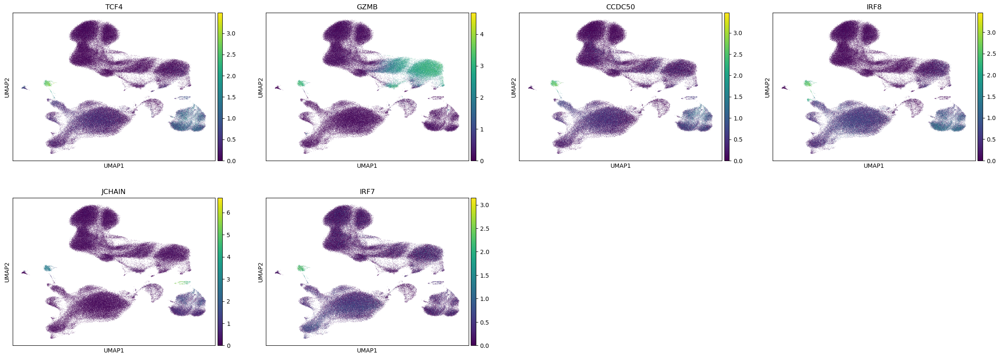

In [58]:
pDC_canon = annot[(annot['Cluster']=='Clus_pDC') & (annot['Cell.Type']=='Plasmacytoid dendritic cell')]['canonical.marker.overlap'].tolist()[0]
print(pDC_canon)
sc.pl.umap(adata, color=pDC_canon)

### Treg

In [59]:
annot[annot['Cluster']=='Clus_Treg']

,Cluster,Cell.Type,Padj,whg.p,gsea.p,Over.Markers.whg,Over.Markers.gsea,canonical.marker.overlap,gsea.DEG.overlap,union
Order,,,,,,,,,,
1,Clus_Treg,Naive regulatory T cell,1.146958e-18,7.321011e-20,NaN,4/11,0/1,"[TIGIT, FOXP3, IKZF2, IL2RA]",,"[TIGIT, FOXP3, IL2RA, IKZF2]"
2,Clus_Treg,T cell,1.146958e-18,3.912332e-21,0.316852,9/221,14/225,"[TIGIT, FOXP3, IL32, TRAC, IL2RA, LEF1, LDHB, ...","[BIRC3, IL32, TRAC, C12orf57, S100A4, S100A10,...","[CXCR4, C12orf57, IL32, S100A10, SOD1, LDHB, B..."
3,Clus_Treg,"CD4-positive, CD25-positive, alpha-beta regula...",1.402648e-16,4.312481e-18,0.063278,4/24,11/230,"[TIGIT, FOXP3, IKZF2, IL2RA]","[RTKN2, TIGIT, FOXP3, IKZF2, IL32, TRAC, S100A...","[CXCR4, IL32, TNFRSF1B, FOXP3, IL2RA, RTKN2, T..."
4,Clus_Treg,Natural T-regulatory cell,2.385212e-13,1.164185e-13,0.006074,3/13,5/133,"[FOXP3, IKZF2, IL2RA]","[TIGIT, IL32, S100A4, IL10RA, S100A10]","[IL10RA, IL32, S100A10, FOXP3, IL2RA, IKZF2, T..."
5,Clus_Treg,"CD4-positive, alpha-beta T cell",1.052042e-10,6.083630e-12,0.075051,6/93,15/281,"[TIGIT, FOXP3, TRAC, IL2RA, LDHB, CD27]","[TIGIT, FOXP3, BIRC3, IL32, TRAC, S100A4, RPL1...","[CXCR4, IL32, SOD1, PIK3R1, LDHB, BIRC3, RCAN3..."
6,Clus_Treg,Induced T-regulatory cell,1.290385e-10,1.921849e-11,NaN,2/4,0/1,"[FOXP3, IL2RA]",,"[FOXP3, IL2RA]"
7,Clus_Treg,"Central memory CD4-positive, alpha-beta T cell",2.803543e-10,4.771988e-11,NaN,4/25,0/1,"[IL32, TRAC, LDHB, CD27]",,"[TRAC, LDHB, CD27, IL32]"
8,Clus_Treg,Naive T cell,4.499498e-07,8.762002e-09,0.598974,3/19,12/192,"[IL2RA, LEF1, CD27]","[RPL36, IL32, TRAC, S100A4, RPL12, RPL8, LEF1,...","[CXCR4, IL32, RPL8, RPL36, LEF1, IL2RA, TRAC, ..."
9,Clus_Treg,Helper T cell,7.952487e-07,3.117878e-07,0.033613,4/57,8/159,"[FOXP3, IL32, IL2RA, CXCR4]","[TIGIT, IL32, TRAC, S100A4, PIK3IP1, CXCR4, RP...","[CXCR4, IL32, FOXP3, IL2RA, TRAC, PIK3IP1, TIG..."


['TIGIT', 'FOXP3', 'IKZF2', 'IL2RA']


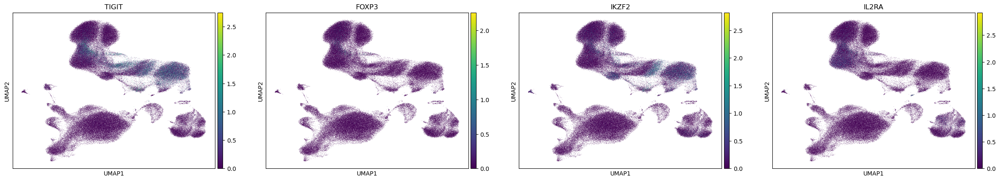

In [60]:
Treg_canon = annot[(annot['Cluster']=='Clus_Treg') & (annot['Cell.Type']=='Naive regulatory T cell')]['canonical.marker.overlap'].tolist()[0]
print(Treg_canon)
sc.pl.umap(adata, color=Treg_canon)